In [ ]:
!pip install multidict

     |████████████████████████████████| 94 kB 2.3 MB/s 


In [ ]:
!pip install -U yellowbrick

In [ ]:
!pip install mpld3

     |████████████████████████████████| 201 kB 5.2 MB/s 


# Ne pas oublier de relancer l'environnement

In [ ]:
# Il faut initialiser le dossier à partir de GitHub
# cette action est à faire une seule fois lors de la première utilisation
!git clone https://github.com/Patent2net/LexiComWebPartners.git

Cloning into 'LexiComWebPartners'...
remote: Enumerating objects: 38, done.
remote: Counting objects: 100% (38/38), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 38 (delta 12), reused 34 (delta 8), pack-reused 0
Unpacking objects: 100% (38/38), done.


In [ ]:
!git clone https://github.com/Patent2net/LexiComWeb.git

Cloning into 'LexiComWeb'...
remote: Enumerating objects: 76, done.
remote: Counting objects: 100% (76/76), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 76 (delta 11), reused 73 (delta 8), pack-reused 0
Unpacking objects: 100% (76/76), done.


In [ ]:
stockageEntree = "/content/LexiComWeb/"
stockageEntreePartners = "/content/LexiComWebPartners/"
stockageSortie = "/content/LexiComWebPartners/"


---
# Personnalisation (Option)

> Ces cellules permettent de réaliser les traitements à partir de son propre espace de stockage. A n'exécuter que dans ce cas en adaptant les dossiers d'entrée et sortie. NE PAS EXECUTER SAUF A VOULOIR PERSONNALISER LES TRAITEMENTS.

Si vous avez exécuté le scraper et reconstitué l'ensemble des dossiers nécessaires sur votre drive, ces cellules vous permettent de configurer ce notebook pour travailler sur vos données et non celles issues du git (accessibles sur un dossier virtuel via le menu *Fichiers* à gauche).

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Récupérer les sorties sur son drive (créer un dossier "OUT")
stockageSortie = "/content/drive/MyDrive/OUT"

In [ ]:
# Récupérer les entrées sur son drive
stockageEntree = "/content/drive/MyDrive/OUT"
stockageEntreePartners  = "/content/drive/MyDrive/OUT" # sur mon drive j'ai tout mélangé.... 

---

In [ ]:
import multidict as multidict

In [ ]:
import pandas as pd
import os
import pprint as pp
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import numpy as np
import matplotlib_inline
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
from collections import Counter
import seaborn as sns
import matplotlib.pyplot as plt
import urllib.parse as parse
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from PIL import Image
from os import path
import json
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator, get_single_color_func
from matplotlib.patches import Patch #NEW
from matplotlib import cm, colors
from urllib import parse as parse
import mpld3

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mpld3 import plugins
from sklearn.manifold import TSNE
import matplotlib
from mpld3 import utils

css = """
table
{
  border-collapse: collapse;
}
th
{
  color: #ffffff;
  background-color: #000000;
}
td
{
  background-color: #cccccc;
}
table, th, td
{
  font-family:Arial, Helvetica, sans-serif;
  border: 1px solid black;
  text-align: right;
}
"""


class ClickInfo(mpld3.plugins.PluginBase):
    """mpld3 Plugin for getting info on click
    Comes from:
        http://stackoverflow.com/a/28838652/814354
    """

    JAVASCRIPT = """
    mpld3.register_plugin("clickinfo", ClickInfo);
    ClickInfo.prototype = Object.create(mpld3.Plugin.prototype);
    ClickInfo.prototype.constructor = ClickInfo;
    ClickInfo.prototype.requiredProps = ["id", "urls"];
    function ClickInfo(fig, props){
        mpld3.Plugin.call(this, fig, props);
    };

    ClickInfo.prototype.draw = function(){
        var obj = mpld3.get_element(this.props.id);
        urls = this.props.urls;
        obj.elements().on("mousedown",
                          function(d, i){
                            window.open(urls[i], '_blank')});
    }
    """
    def __init__(self, points, urls):
        self.points = points
        self.urls = urls
        if isinstance(points, matplotlib.lines.Line2D):
            suffix = "pts"
        else:
            suffix = None
        self.dict_ = {"type": "clickinfo",
                      "id": mpld3.utils.get_id(points, suffix),
                      "urls": urls}

In [ ]:
#%matplotlib inline

In [ ]:
os.chdir('/content/LexiComWeb/RESSOURCES/')

In [ ]:
from outils import makeImage, makeImage2,clean, Palette, NettoieLabels, isPartner 

# Chargement des données de référence

## Stats

In [ ]:
stats = dict()
for ndf in os.listdir(stockageEntree +"/ContenusSites/"):
  if not ndf.startswith('.')  and "backlinks" not in ndf and 'stats' not in ndf :
    fichierEntree = stockageEntree +'/ContenusSites/' +ndf
    with open(fichierEntree, 'r') as  fictemp: #pour ouvrir les contenus 
      soup = json.load(fictemp)
    index = list([url for url in soup.keys()])

    data  = [len(soup[url]) for url in index ]
    donnees = pd.DataFrame.from_dict(data)
    donnees.index = index
    donnees.columns=["taille"]
    stats [ndf]  = donnees.describe()

 # stats contient la description statistique des données fondée sur la taille
 # de celle-ci. Cette variable servira a exclure les url dont la variation
 # à la moyenne est trop importante : trop ou pas assez sont considérés comme
 # des singularités. Cela peut provenir de la forme choisie pour la page (grande
 # page qui contient "tout" avec un ascenceur interminable ou page composée
 # par des appels url en js que le collecteur ne reconstruit pas) 

In [ ]:
stats

In [ ]:
soup.keys()

dict_keys(['http://la-seyne.fr', 'http://le-pradet.fr', 'http://isere.fr', 'http://hyeres.fr', 'http://ville-lagarde.fr', 'http://toulon.fr', 'http://carqueiranne.fr', 'http://villedelacrau.fr'])

## Sites de référence

### Toutes les données
> issues de  [LexiComWeb](https://doi.org/10.5281/zenodo.5919879)

In [ ]:
import json
with open(stockageEntreePartners + '/ContenusPartnersTraites/PNPC.json', 'r', encoding='utf-8') as f:
    PNPC = json.load(f)

In [ ]:
import json
with open(stockageEntree + '/RESSOURCES/Sites.json', 'r', encoding='utf-8') as f:
    CatSites = json.load(f)

In [ ]:
fichierEntree = stockageEntree +'/ContenusTraites/' +"verbesSites.json"
with open (fichierEntree, 'r', encoding='utf-8') as  fictemp: #on récupère tous les contenus dans pickle
  Refverbes = json.load(fictemp)

fichierEntree = stockageEntree +'/ContenusTraites/' +'nomsSites.json'
with open (fichierEntree, 'r', encoding='utf-8') as  fictemp: #on récupère tous les contenus dans pickle
  Refnoms = json.load(fictemp)

fichierEntree = stockageEntree +'/ContenusTraites/' +'adjectifsSites.json'
with open (fichierEntree, 'r', encoding='utf-8') as  fictemp: #on récupère tous les contenus dans pickle
  Refadjectifs = json.load( fictemp)

fichierEntree = stockageEntree +'/ContenusTraites/' +'Etiquettes.json'
with open (fichierEntree, 'r', encoding='utf-8') as  fictemp: #on récupère tous les contenus dans pickle
  RefdicoEtiquettage = json.load(fictemp)

In [ ]:
RefdicoEtiquettage ['parcs'] .keys()

dict_keys(['http://www.vanoise-parcnational.fr/fr', 'http://www.pyrenees-parcnational.fr/fr', 'http://www.cevennes-parcnational.fr/fr', 'http://www.ecrins-parcnational.fr/', 'http://www.mercantour-parcnational.fr/fr', 'http://www.guadeloupe-parcnational.fr/fr', 'http://www.parc-amazonien-guyane.fr/fr', 'http://www.reunion-parcnational.fr/fr', 'http://www.calanques-parcnational.fr/fr', 'http://www.forets-parcnational.fr/fr'])

## Partenaires



In [ ]:
fichierEntree = stockageEntreePartners +'/ContenusPartnersTraites/' +"EtiquettesPartners.json"
with open (fichierEntree, 'r') as  fictemp: #on récupère tous les contenus dans pickle
  PartnersdicoEtiquettage = json.load(fictemp)

In [ ]:
PartnersParCat = dict()
for url in PartnersdicoEtiquettage .keys():
  for cat in CatSites .keys():
    if isPartner(url, CatSites[cat][0]):
      if cat in PartnersParCat .keys():
        PartnersParCat[cat].append(url)
      else:
        PartnersParCat[cat] = [url]

In [ ]:
PartnersParCat .values()

dict_values([['http://ofb.gouv.fr', 'http://ecologique-solidaire.gouv.fr'], ['http://hyeres-tourisme.com', 'http://ramatuelle-tourisme.com', 'http://lepradet-tourisme.fr', 'http://provence-alpes-cotedazur.com', 'http://visitvar.fr'], ['http://tlv-tvm.com', 'http://bateauxverts.com', 'http://lesbateliersdelarade.com', 'http://vedettesilesdor.fr', 'http://bateliersdelacotedazur.com', 'http://latitudeverte.fr', 'http://bateauxsaintraphael.com', 'http://reseaumistral.com'], ['http://bateaux-taxi.com'], ['http://sanctuaire-pelagos.org'], ['http://villanoailles-hyeres.com'], ['http://ville-lagarde.fr']])

In [ ]:
PartnersdicoEtiquettage .keys()

dict_keys(['http://alizee-soft.com', 'http://pyrenees-parcnational.fr', 'http://guadeloupe-parcnational.fr', 'http://calanques-parcnational.fr', 'http://ecrins-parcnational.fr', 'http://colleo.fr', 'http://cevennes-parcnational.fr', 'http://espritparcnationalportcros.com', 'http://forets-parcnational.fr', 'http://ofb.gouv.fr', 'http://parcsnationaux.fr', 'http://portcrosparcnational.fr', 'http://mercantour.eu', 'http://reunion-parcnational.fr', 'http://parc-amazonien-guyane.fr', 'http://www.var.gouv.fr', 'http://vanoise-parcnational.fr', 'https://vanoise-parcnational.fr', 'http://espritparcnational.com', 'http://ac-nice.fr', 'http://premar-mediterranee.gouv.fr', 'http://hyeres-tourisme.com', 'http://festival-galathea.com', 'http://tlv-tvm.com', 'http://bateauxverts.com', 'https://bateauxverts.com', 'http://lesbateliersdelarade.com', 'http://vedettesilesdor.fr', 'http://bateliersdelacotedazur.com', 'http://bateaux-taxi.com', 'http://latitudeverte.fr', 'http://bateauxsaintraphael.com', '

In [ ]:
PartnersParCat 

{'Hebergements': ['http://villanoailles-hyeres.com'],
 'Services': ['http://tlv-tvm.com',
  'http://bateauxverts.com',
  'http://lesbateliersdelarade.com',
  'http://vedettesilesdor.fr',
  'http://bateliersdelacotedazur.com',
  'http://latitudeverte.fr',
  'http://bateauxsaintraphael.com',
  'http://reseaumistral.com'],
 'gouv': ['http://ofb.gouv.fr', 'http://ecologique-solidaire.gouv.fr'],
 'locations': ['http://bateaux-taxi.com'],
 'mairies': ['http://ville-lagarde.fr'],
 'oTourism': ['http://hyeres-tourisme.com',
  'http://ramatuelle-tourisme.com',
  'http://lepradet-tourisme.fr',
  'http://provence-alpes-cotedazur.com',
  'http://visitvar.fr'],
 'orga': ['http://sanctuaire-pelagos.org']}

In [ ]:
from urllib import parse
lstSite, dnsStite =[], []
SiteAExclure = ['http://colleo.fr' ] # au cas où resterait un site collecté par erreur par ex. facebook (qui sans login n'est qu'une page de connexion)
for url in PartnersdicoEtiquettage .keys():
  if url not in SiteAExclure:
    urlP = parse.urlparse(url)
    lstSite .append(urlP.scheme + '://' + urlP.hostname)
    dnsStite .append(urlP.hostname)


In [ ]:
fait, retenu =[],[]
for url in PartnersdicoEtiquettage .keys():
  if url not in SiteAExclure:
    urlP = parse.urlparse(url)
    if dnsStite.count(urlP.hostname) >1:
      if urlP.hostname not in fait:
        retenu .append(urlP.scheme + '://' + urlP.hostname)
        fait .append(urlP.hostname)
      else:
        pass
    else:
      retenu .append(urlP.scheme + '://' + urlP.hostname)
      fait .append(urlP.hostname)

In [ ]:
retenu

['http://alizee-soft.com',
 'http://pyrenees-parcnational.fr',
 'http://guadeloupe-parcnational.fr',
 'http://calanques-parcnational.fr',
 'http://ecrins-parcnational.fr',
 'http://colleo.fr',
 'http://cevennes-parcnational.fr',
 'http://espritparcnationalportcros.com',
 'http://forets-parcnational.fr',
 'http://ofb.gouv.fr',
 'http://parcsnationaux.fr',
 'http://portcrosparcnational.fr',
 'http://mercantour.eu',
 'http://reunion-parcnational.fr',
 'http://parc-amazonien-guyane.fr',
 'http://www.var.gouv.fr',
 'http://vanoise-parcnational.fr',
 'http://espritparcnational.com',
 'http://ac-nice.fr',
 'http://premar-mediterranee.gouv.fr',
 'http://hyeres-tourisme.com',
 'http://festival-galathea.com',
 'http://tlv-tvm.com',
 'http://bateauxverts.com',
 'http://lesbateliersdelarade.com',
 'http://vedettesilesdor.fr',
 'http://bateliersdelacotedazur.com',
 'http://bateaux-taxi.com',
 'http://latitudeverte.fr',
 'http://bateauxsaintraphael.com',
 'http://reseaumistral.com',
 'http://sauvage

In [ ]:
CatSitesPropre =[]

for typ in CatSites .keys():
  for url in CatSites [typ] [0]:
    urlP = parse.urlparse(url)
    CatSitesPropre .append(urlP.hostname)
    CatSitesPropre .append(urlP.hostname .replace('www.', ''))
    CatSitesPropre .append(urlP.scheme + '://' + urlP.hostname)
    if 's' not in urlP.scheme:
      CatSitesPropre .append(urlP.scheme + 's://'+ urlP.hostname)
    else:
      CatSitesPropre .append('http://'+ urlP.hostname)

In [ ]:
CatSites ["parcs"]

[['http://www.vanoise-parcnational.fr/fr',
  'http://www.pyrenees-parcnational.fr/fr',
  'http://www.cevennes-parcnational.fr/fr',
  'http://www.ecrins-parcnational.fr/',
  'http://www.mercantour-parcnational.fr/fr',
  'http://www.guadeloupe-parcnational.fr/fr',
  'http://www.parc-amazonien-guyane.fr/fr',
  'http://www.reunion-parcnational.fr/fr',
  'http://www.calanques-parcnational.fr/fr',
  'http://www.forets-parcnational.fr/fr'],
 'parcs']

In [ ]:
partnersSansTyp = [url for url in retenu if url not in CatSitesPropre and parse.urlparse(url).hostname not in CatSitesPropre]

In [ ]:
partnersSansTypEtiquettage, partnersAvecTypEtiquettage = dict(), dict()
for url in PartnersdicoEtiquettage .keys():
  if url in partnersSansTyp and url not in SiteAExclure:
    partnersSansTypEtiquettage [url] = PartnersdicoEtiquettage [url]
  elif url not in SiteAExclure:
    partnersAvecTypEtiquettage [url] = PartnersdicoEtiquettage [url]

In [ ]:
catGrams = ['LOC', 'MISC', 'PER', 'ORG', 'NOUN', 'ADJ', 'VERB', 'ADV']

In [ ]:
RefdicoEtiquettagePlat = dict()
for ndf in RefdicoEtiquettage .keys():
  RefdicoEtiquettagePlat[ndf] =dict()

  for url in RefdicoEtiquettage[ndf] .keys():
    for cat in catGrams:
      text =  []
      for url in RefdicoEtiquettage[ndf] .keys():
        if cat in RefdicoEtiquettage[ndf][url] .keys():
          text .extend (RefdicoEtiquettage[ndf][url][cat])
      RefdicoEtiquettagePlat[ndf] [cat] = text

In [ ]:
# Ajout des classes partenaires (ceux qui sont inclus dans la typologie et les autres)
RefdicoEtiquettagePlat ["partnersSansTyp"] = dict()
RefdicoEtiquettagePlat ["partnersAvecTyp"] = dict()
for url in partnersSansTypEtiquettage.keys():
  for cat in partnersSansTypEtiquettage [url] .keys():
    if cat in RefdicoEtiquettagePlat ["partnersSansTyp"] .keys():
      RefdicoEtiquettagePlat ["partnersSansTyp"][cat] .extend(partnersSansTypEtiquettage [url][cat])
    else:
      RefdicoEtiquettagePlat ["partnersSansTyp"][cat] = partnersSansTypEtiquettage [url][cat]

for url in partnersAvecTypEtiquettage.keys():
  for cat in partnersAvecTypEtiquettage [url] .keys():
    if cat in RefdicoEtiquettagePlat ["partnersAvecTyp"] .keys():
      RefdicoEtiquettagePlat ["partnersAvecTyp"][cat] .extend(partnersAvecTypEtiquettage [url][cat])
    else:
      RefdicoEtiquettagePlat ["partnersAvecTyp"][cat] = partnersAvecTypEtiquettage [url][cat]

## Communs et 𝚫





> séparation des spécificités lexicales par typologie de sites.

In [ ]:
pp.pprint(RefdicoEtiquettage ['parcs'].keys())

dict_keys(['http://www.vanoise-parcnational.fr/fr', 'http://www.pyrenees-parcnational.fr/fr', 'http://www.cevennes-parcnational.fr/fr', 'http://www.ecrins-parcnational.fr/', 'http://www.mercantour-parcnational.fr/fr', 'http://www.guadeloupe-parcnational.fr/fr', 'http://www.parc-amazonien-guyane.fr/fr', 'http://www.reunion-parcnational.fr/fr', 'http://www.calanques-parcnational.fr/fr', 'http://www.forets-parcnational.fr/fr'])


In [ ]:
catGrams = ['LOC', 'MISC', 'PER', 'ORG', 'NOUN', 'ADJ', 'VERB', 'ADV']
CountMots = dict()
for ndf in RefdicoEtiquettagePlat .keys():
  CountMots[ndf] =dict()
  for cat in catGrams:
    CountMots[ndf][cat] = Counter (RefdicoEtiquettagePlat [ndf][cat])


In [ ]:
CountMotsParners = dict()
for ndf in partnersAvecTypEtiquettage .keys():
  CountMotsParners[ndf] =dict()
  for cat in partnersAvecTypEtiquettage[ndf] .keys():
    CountMotsParners[ndf][cat] = Counter (partnersAvecTypEtiquettage[ndf][cat])


### Séparation des termes
> 3 blocs séparés dans 3 variables distinguant les catégories grammaticales : 

1. les mots communs à toutes les catégories de sites (mots trivaux en général) :  *communsExclusifs*

2. les mots communs à deux catégories de sites : *communs*

3. les mots exclusifs à chaque catégorie de site : *diff*

In [ ]:
def clean2(terme, aExclure):
  if len(terme)<3 or terme .lower() in aExclure:
    return False
  elif terme.isalpha():
    return True
  elif '-' in terme and not terme.startswith('-'):
    terme = terme.replace("-", "")
    if terme.isalpha():
      return True
    else:
      return False
  else:
    return False 


In [ ]:
aExclure =['required', "created",'acceoter', 'ensure', 'record', 'consented', 'perform', 'sharing', 'analyze', 'helps', 'delivering', 'analyzed', 'classified', 'analyze', 'helps', 'delivering', 'month', 'plugin', 'category', 'visitor', 'crossing', 'calle', 'comment', 'cheer', 'intracomm', 'inflatabl','dimitil']

In [ ]:
catGram = ["VERB", "ADJ", "ADV", "NOUN"]

In [ ]:
communsExclusifs = dict() # pour chaque catégorie, les termes communs à TOUS

for ndf in CountMots.keys():
  communsExclusifs[ndf] = dict()

for ndf in CountMots.keys():
  autres = list(CountMots.keys())
  autres.remove(ndf) 
  for cat in catGram:
    # initialisation
    communsExclusifs[ndf][cat] = set(CountMots[ndf][cat].keys()).intersection(set(CountMots[autres [0]][cat].keys()))

  for cat in catGram:
    for ens in autres:
      #print (ndf, '  ', ens, '  ',cat, '  ',len(CountMots [ens][cat].keys()))
      communsExclusifs[ndf][cat] = communsExclusifs[ndf][cat].intersection(set(CountMots[ens][cat].keys()))

  for cat in catGram:   # nettoyage
    communsExclusifs[ndf][cat] = [truc for truc in communsExclusifs[ndf][cat] if clean2(truc, aExclure)]

    #print(len (communsExclusifs [ndf][cat]))

In [ ]:
communs = dict() # pour chaque catégorie, les termes communs à au moins deux

for ndf in CountMots.keys():
  communs[ndf] = dict()

for ndf in CountMots.keys():
  autres = list(CountMots.keys())
  autres.remove(ndf) 
  for cat in catGram:
    # initialisation
    communs[ndf][cat] = set()
  for cat in catGram:
    for ens in autres:
      communs[ndf][cat] = communs[ndf][cat] .union(set(CountMots[ndf][cat].keys()) .intersection(set(CountMots[ens][cat].keys())))
      #print (ndf, '  ', ens, '  ',cat, '  ',len(CountMots [ens][cat].keys()), len(communs [ndf][cat]))
# on évite aussi ceux qui sont communs à tous retrouvés précédemment
for ndf in CountMots.keys():  
  for cat in catGram:
    #print(len (communs [ndf][cat]))
    communs[ndf][cat] = [truc for truc in communs[ndf][cat] if truc not in communsExclusifs[ndf][cat] and clean2(truc, aExclure)]
    #print(len (communs [ndf][cat]))

In [ ]:
communs[ndf]

In [ ]:
diff = dict()
for ndf in CountMots.keys():
  diff[ndf] = dict()

for ndf in CountMots.keys(): 
  for cat in catGram:
    #diff [ndf] [cat] = set()
    diff[ndf][cat] = [mot for mot in CountMots[ndf][cat].keys() if mot not in communs[ndf][cat] and mot not in communsExclusifs[ndf][cat] and clean2(mot, aExclure)]

In [ ]:
for tip in diff.keys():
  print (tip, diff[tip])

Gouv {'VERB': ['transverse', 'intéresser', 'redynamiser', 'témoigner', 'éteindre', 'révolutionner', 'déconcentrer', 'réagir', 'félicite'], 'ADJ': ['co-gestionnair', 'agroalimentaire', 'agroécologiqu', 'vétérinaire', 'aviaire', 'biosourcé', 'laitier', 'consultatif', 'franco-mongol', 'pérenne', 'spatio', 'temporel', 'diplomatique', 'consulaire', 'humanitaire', 'féministe', 'uni', 'arctique', 'bilatéral', 'saoudite', 'comore', 'arabe', 'fédéré', 'équatorial', 'palestinien', 'centrafricain', 'dominicain', 'tchèque', 'franco-allemande', 'structurant'], 'ADV': [], 'NOUN': ['footer', 'pac', 'simplification', 'désertification', 'influenza', 'svg', 'attendu', 'biotechnologie', 'mal-être', 'solitude', 'vigicrue', 'recosanté', 'dioxyde', 'titane', 'additif', 'denrée', 'loire', 'egalité', 'ethnologie', 'dépêche', 'cathédrale', 'chevet', 'fiction', 'scénariste', 'discours', 'nomination', 'orangerie', 'tuilerie', 'diplomatie', 'lanceur', 'immunité', 'francophonie', 'nation', 'désarmement', 'non-prol

### Cohérence

> spacy peut générer des erreurs de catégorisation, d'autant plus que nos textes sont extraits d'une page Web : la structure textuelle est rompue. De fait, certains termes peuvent être, selon les sites, affectés à des catégories grammaticales différentes par erreur ou parce que ce sont unités lexicales morphologiquement ambiguës.

Le choix est fait de les éliminer. Le code ci-dessous les affiche et les élimine

In [ ]:
# test de cohérence et séparation des mots entre les différents types
# a rééxécuter deux fois
test = [mot for cle in diff.keys() for cat in catGram for mot in diff[cle][cat] if mot in communs[cle][cat]]
print(test, " <-- termes communs entre diff et communs (doit être vide)")
print(" termes communs de chaque type de site pour toute catégorie grammaticale avec n'importe quel autre type (devrait être vide)")
for cle in diff.keys():
  autres = list(diff.keys())
  autres.remove(cle)
  autresMots = [mot for key in autres for cat in catGram for mot in diff[key][cat]]
  test = [mot for cat in catGram for mot in diff[cle][cat] if mot in autresMots]
  # type de site, terme et catégorie grammaticale
  print (cle, test)
  for truc in test:
    for cat in catGram:
      for key in diff.keys():
          if truc in diff[key][cat]:
            print (cle, truc, key, cat)
            # suppression 
            diff [key][cat].remove(truc)

In [ ]:
diff.keys()

dict_keys(['oTourism', 'Gouv', 'parcs', 'organisations', 'Services', 'Hebergement', 'restauration', 'locations', 'mairies', 'partnersSansTyp', 'partnersAvecTyp'])

In [ ]:
fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'communs.json'
with open (fichierDeSortie, 'w', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  json.dump(communs, fictemp)

fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'communsExclusifs.json'
with open (fichierDeSortie, 'w', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  json.dump(communsExclusifs, fictemp)

fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'diff.json'
with open (fichierDeSortie, 'w', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  json.dump(diff, fictemp)

In [ ]:
fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'communs.json'
with open (fichierDeSortie, 'r', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  communs = json.load(fictemp)

fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'communsExclusifs.json'
with open (fichierDeSortie, 'r', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  communsExclusifs = json.load(fictemp)

fichierDeSortie = stockageEntreePartners +'/ComparaisonContenusPartners/' +'diff.json'
with open (fichierDeSortie, 'r', encoding ='utf8') as  fictemp: #on met tous les contenus dans pickle
  diff = json.load(fictemp)


# Représentations exploratoires

> Permettent d'apprécier à la fois l'intérêt des extractions réalisées (les thématiques de lexique s'identifient aisément aux classes de la typologie). Par ex. Les offices de tourisme communiquent sur les thèmes du voyage (faire,partir, venir), de la découverte, etc. La classe des parcs (qui ne contient que des sites de parcs nationaux) permet d'extraire le lexique propre à cette organisation de façon équilibrée (ratio des occurrences comparable) ce que l'on ne retrouve pas dans toutes les classes. Cet élément pourrait constituer un critère de construction de classes de sites.
Mais le procédé laisse entrevoir aussi des limites : en témoigne la présence de termes ayant échappé aux procédés de filtrage, des exemples d'erreurs de lemmatisation ("moin",  "presqu'", etc.) ou autres (nombres, numéros, mots en anglais probablement du lexique des langages de programmation). .

In [ ]:
2# on génère la palette de couleurs
categorieSites = list(RefdicoEtiquettagePlat.keys())
categorieSites.append( 'PNPC')
palette = Palette(categorieSites) 

In [ ]:
diff .keys()

dict_keys(['Gouv', 'parcs', 'organisations', 'oTourism', 'Services', 'Hebergement', 'restauration', 'locations', 'mairies', 'partnersSansTyp', 'partnersAvecTyp'])

In [ ]:
# on affecte les mots de chaque classe à une couleur de la palette
couleursMots = dict()
motsCouleurs = dict()
for cle in RefdicoEtiquettagePlat.keys():
  couleursMots[colors.to_hex((palette[cle]))] = []
for cle in RefdicoEtiquettagePlat.keys():  
  for cat in catGram:
    for mot in set(diff[cle][cat]):
      couleursMots[colors.to_hex((palette[cle]))].append(mot) # à une couleur hexa des mots
      motsCouleurs[mot] = (int(palette[cle][0]*255), int(palette[cle][1]*255), int(palette[cle][2]*255)) # à un mot une couleur RVB


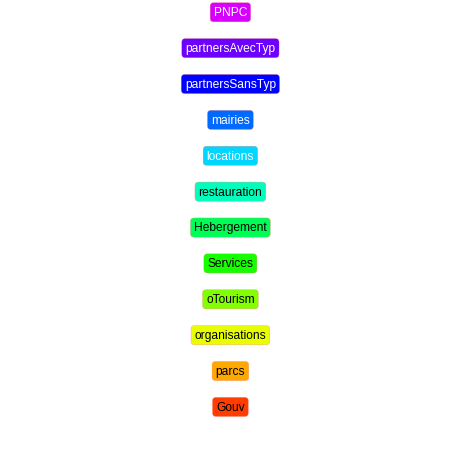

In [ ]:
# légende à priori
y = 0

for cle in palette.keys():
  #print(cle, " ---> ", colors.to_hex(palette[cle]), int(palette[cle][2]))
  y += .12
  plt.text(0.5, y, cle, size=12, rotation=0,
         ha="center", va="center", color = (0+int(palette[cle][2]) , 0 +int(palette[cle][2]), 0 +int(palette[cle][2])),
         bbox=dict(boxstyle="round",
                   ec=(1., 0.5 , 0.5 ),
                   fc=palette[cle],
                   )
         )
plt.axis("off")

plt.savefig(stockageSortie + "/legendeTypSites.png")

plt.show()

In [ ]:
RefdicoEtiquettagePlat ["partnersAvecTyp"] .keys()

dict_keys(['LOC', 'MISC', 'ORG', 'PER', 'NOUN', 'ADJ', 'VERB', 'ADV'])

In [ ]:
PNPC.keys()

dict_keys(['LOC', 'MISC', 'ORG', 'PER', 'NOUN', 'ADJ', 'VERB', 'ADV'])

partnersAvecTyp VERB 101 3


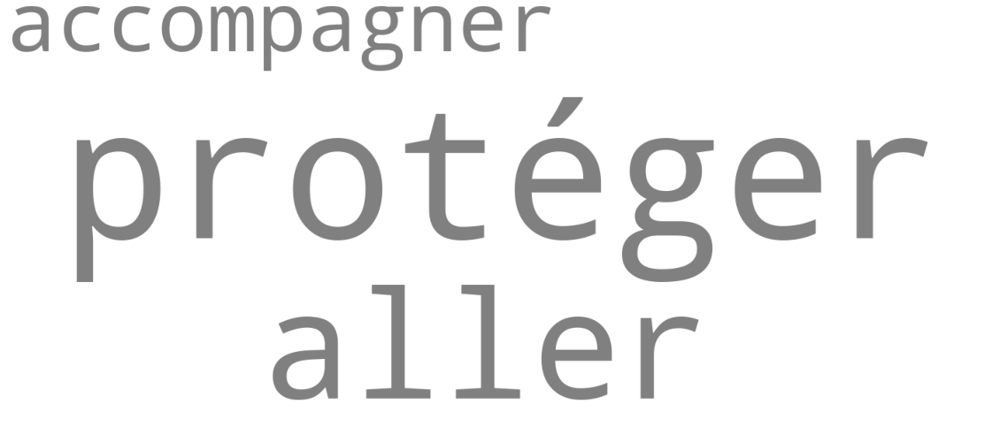

partnersAvecTyp ADJ 498 10


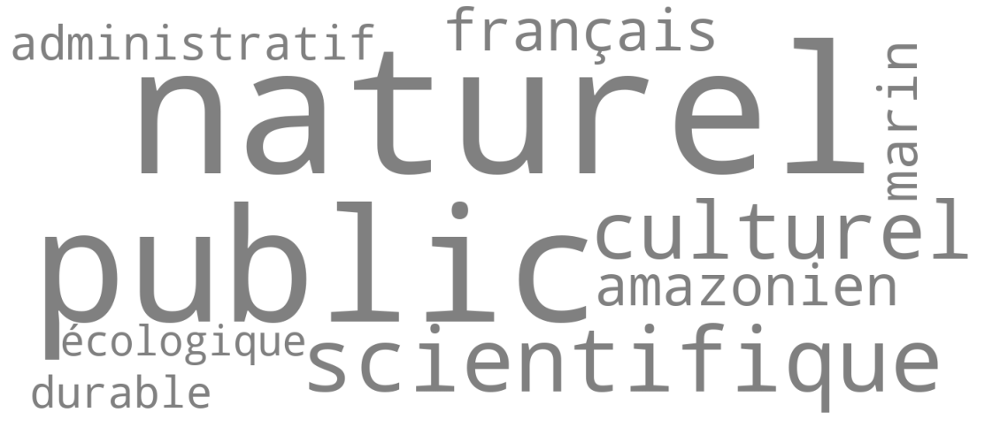

partnersAvecTyp ADV 0 0
partnersAvecTyp NOUN 1921 45


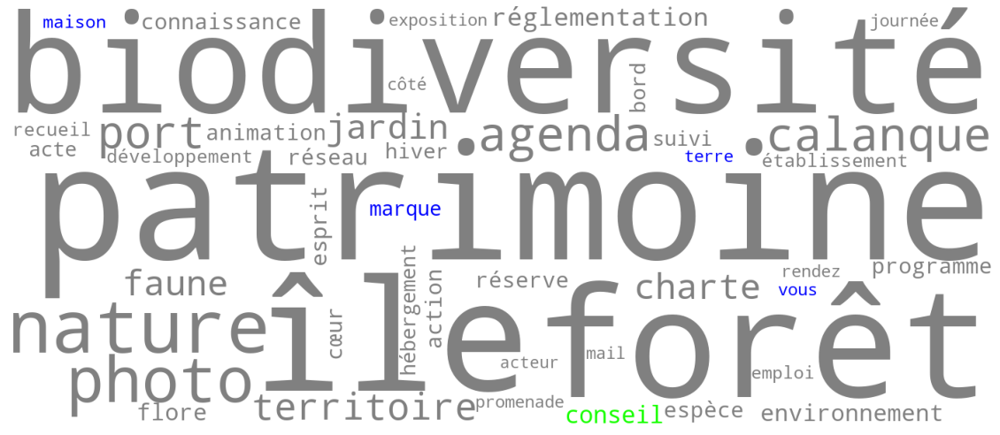

In [ ]:
tempo = dict()
seuil2 = 1
seuil = 20 # occurence à partir de laquelle démarrer
ndf = "partnersAvecTyp" # PartnersAvecTyp 
#for ndf in RefdicoEtiquettagePlat .keys():
for cat in catGram: #RefdicoEtiquettagePlat [ndf].keys():
    tempo[cat] = ""
    if cat in CountMots[ndf] .keys():
      seuil2 = max([CountMots[ndf][cat][mot] for mot in CountMots[ndf][cat]]) #seuil
      for mot in communs[ndf][cat]:
        if CountMots[ndf][cat][mot] >seuil and CountMots[ndf][cat][mot] <seuil2 and clean2(mot, aExclure) and mot in PNPC [cat]:
          # if cat in diff [ndf] .keys():
            # if mot in diff [ndf][cat]:
              tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
      print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    if len(tempo [cat])>0:
      makeImage(tempo[cat], palette, couleursMots)

## Représentations mixant plusieurs catégories de sites sur les partenaires

> Faire varier le seuil pour modifier les représentations selon les occurrences souhaitées. Le seuil max évite l'occurrence la plus importante.

Remplacer la valeur de ndf pour les partenaires selon la typologie 

Gouv VERB 0 0
Gouv ADJ 0 0
Gouv ADV 0 0
Gouv NOUN 0 0
parcs VERB 0 0
parcs ADJ 0 0
parcs ADV 0 0
parcs NOUN 0 0
organisations VERB 0 0
organisations ADJ 28 1


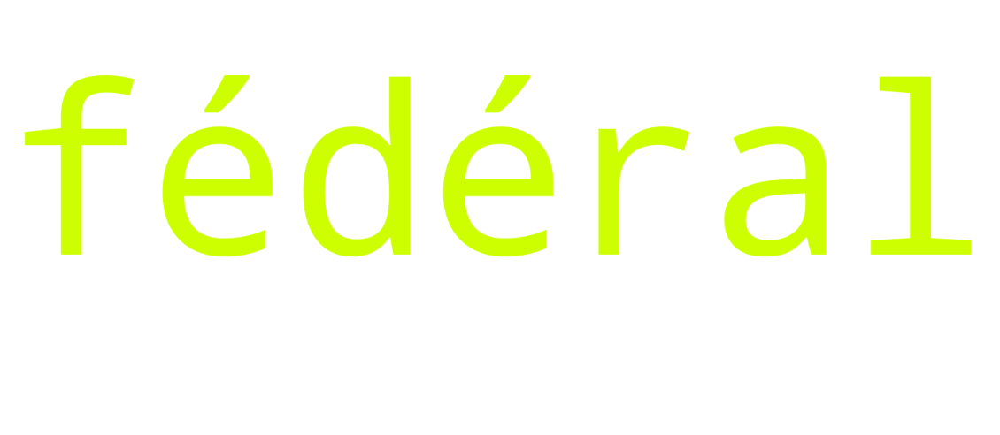

organisations ADV 0 0
organisations NOUN 0 0
oTourism VERB 0 0
oTourism ADJ 0 0
oTourism ADV 0 0
oTourism NOUN 0 0
Services VERB 0 0
Services ADJ 0 0
Services ADV 0 0
Services NOUN 258 9


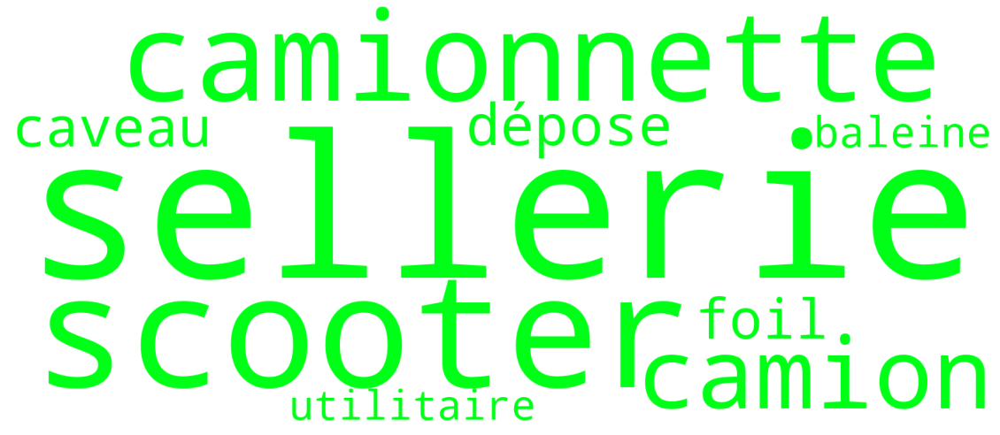

Hebergement VERB 24 1


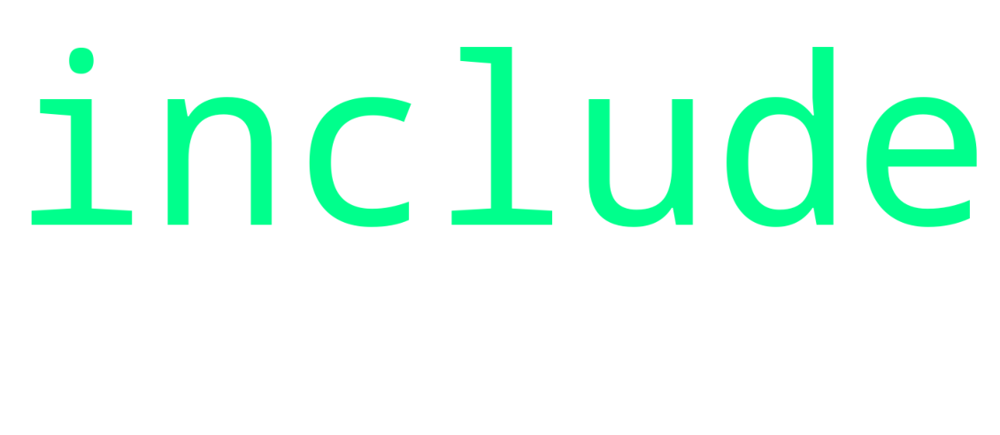

Hebergement ADJ 24 1


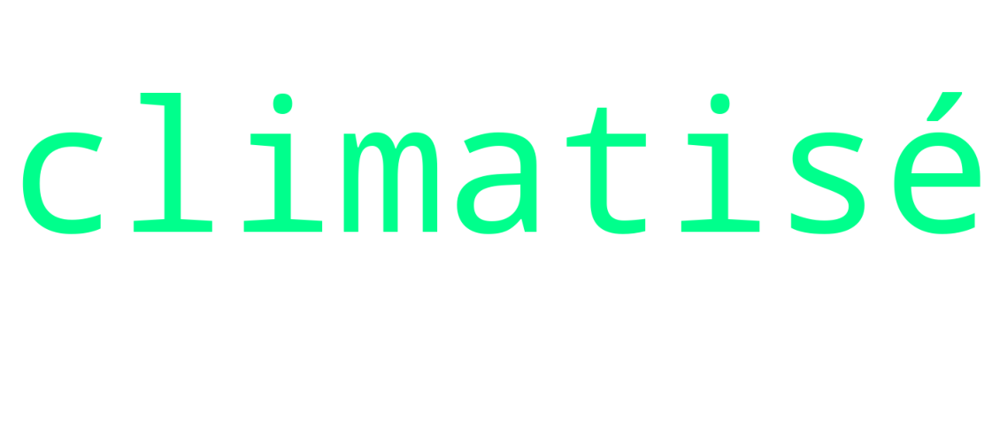

Hebergement ADV 0 0
Hebergement NOUN 453 9


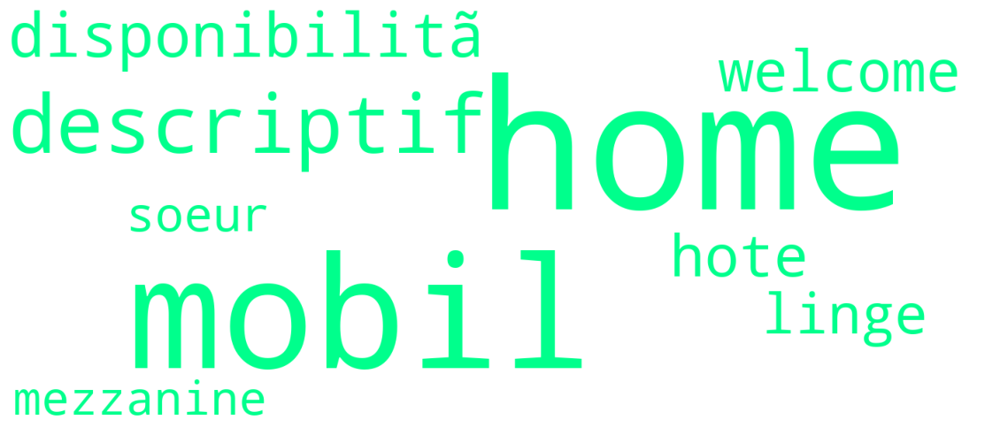

restauration VERB 0 0
restauration ADJ 0 0
restauration ADV 0 0
restauration NOUN 0 0
locations VERB 0 0
locations ADJ 30 1


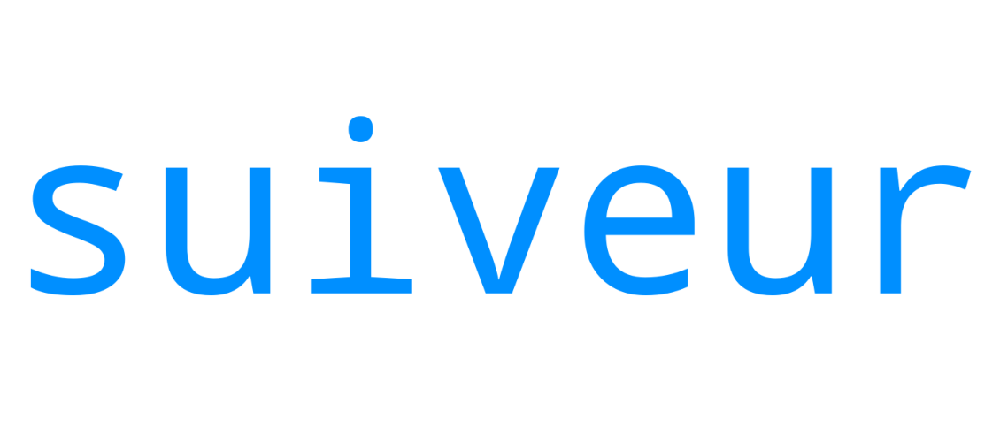

locations ADV 0 0
locations NOUN 37 1


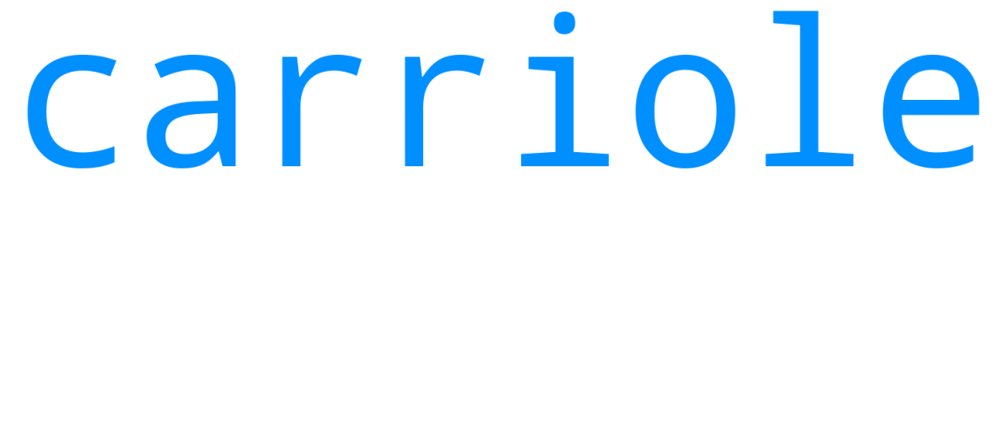

mairies VERB 0 0
mairies ADJ 0 0
mairies ADV 0 0
mairies NOUN 0 0
partnersSansTyp VERB 0 0
partnersSansTyp ADJ 0 0
partnersSansTyp ADV 0 0
partnersSansTyp NOUN 23 1


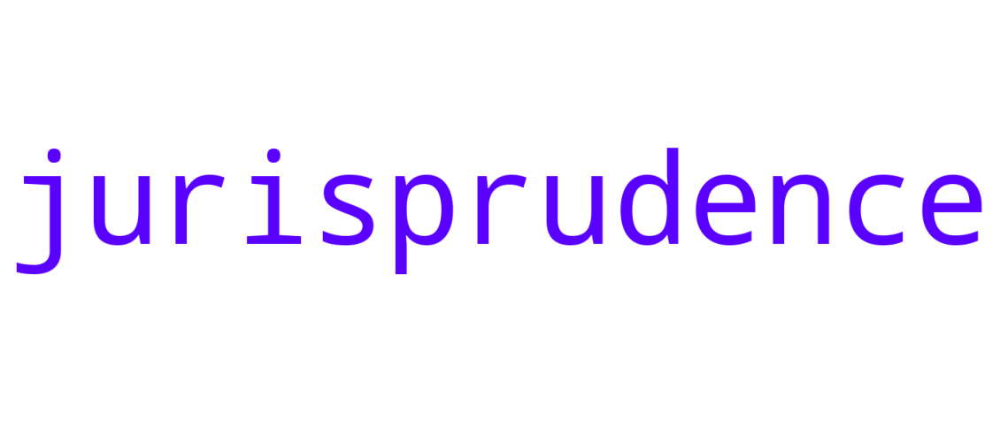

partnersAvecTyp VERB 0 0
partnersAvecTyp ADJ 0 0
partnersAvecTyp ADV 0 0
partnersAvecTyp NOUN 0 0


In [ ]:
tempo = dict()
seuil2 = 1
seuil = 20 # occurence à partir de laquelle démarrer
ndf = "partnersSansTyp" # PartnersAvecTyp 
for ndf in RefdicoEtiquettagePlat .keys():
  for cat in catGram: #RefdicoEtiquettagePlat [ndf].keys():
    tempo[cat] = ""
    if cat in CountMots[ndf] .keys():
      seuil2 = max([CountMots[ndf][cat][mot] for mot in CountMots[ndf][cat]]) #seuil
      for mot in diff[ndf][cat]:
        if CountMots[ndf][cat][mot] >seuil and CountMots[ndf][cat][mot] <seuil2 and clean2(mot, aExclure):
          # if cat in diff [ndf] .keys():
            # if mot in diff [ndf][cat]:
              tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
      print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    if len(tempo [cat])>0:
      makeImage(tempo[cat], palette, couleursMots)

In [ ]:
CountMots .keys()

## Focus sur le champ lexical des partenaires de la classe "location"



In [ ]:
locs = []
for url in partnersAvecTypEtiquettage .keys():
  if url in CatSites ['locations'][0]:
    locs .append(url)

http://bateaux-taxi.com uoupi


In [ ]:
for url in locs:
  for cat in catGram:

    makeImage2(Counter(partnersAvecTypEtiquettage[url][cat]), palette, couleursMots, leg = False)

In [ ]:
Counter(partnersAvecTypEtiquettage[url][cat])

## Représentations mixant plusieurs catégories de sites

> Les représentations ci-dessous n'ont pas vraiment de sens, mêlant toutes les catégories de sites qui contiennent à la fois des nombres de sites différents et très probablement des catégories de sites pas forcément optimales par leur diversité dans notre cas d'étude. 

Par ex. les classes hébergement et restauration auraient pu être séparées pour que toute entité mêlant les deux services soit vue comme relevant des deux classes. Dans le cas présent la non disjonction stricte des deux classes laisse la représentation des sites dépendante du nombre d'occurences de termes relevant d'une classe ou d'une autre sur simple effet de bord.

Gouv VERB 387 50


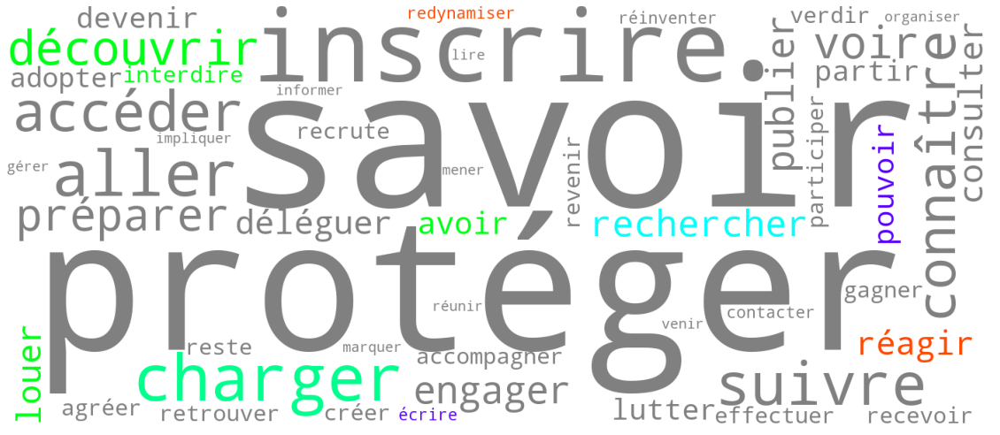

Gouv ADJ 850 78


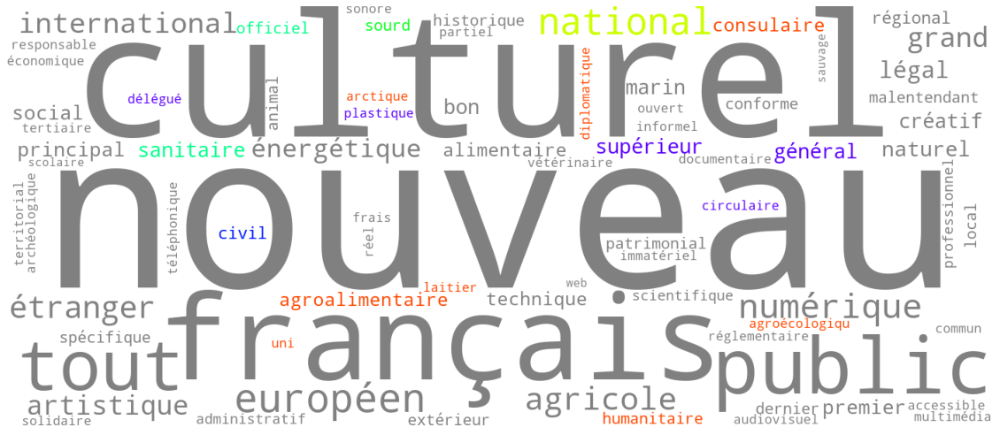

Gouv ADV 43 7


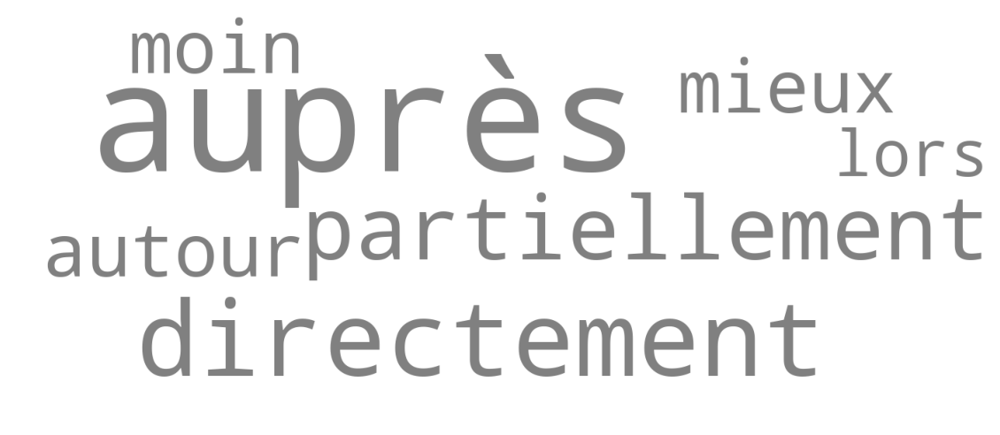

Gouv NOUN 2990 313


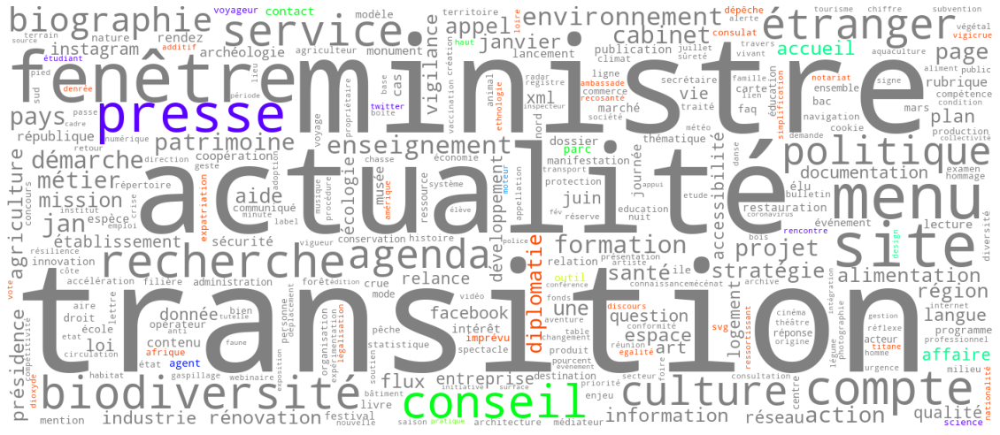

parcs VERB 783 103


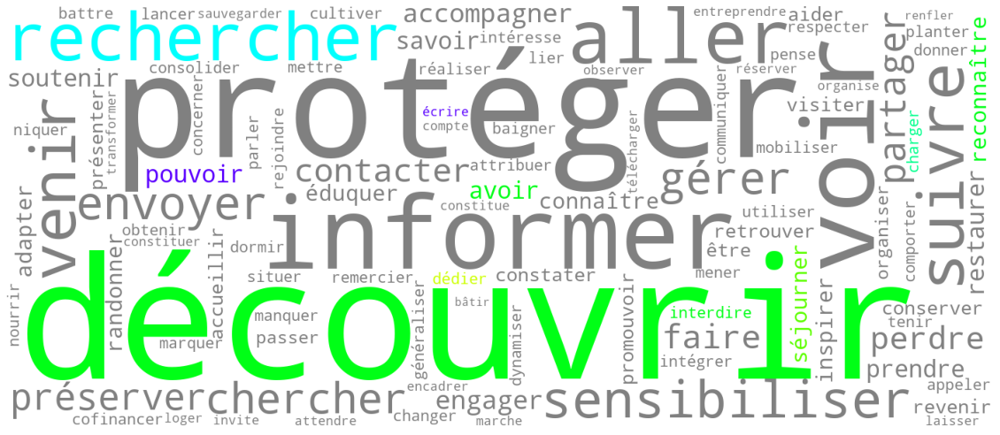

parcs ADJ 2048 163


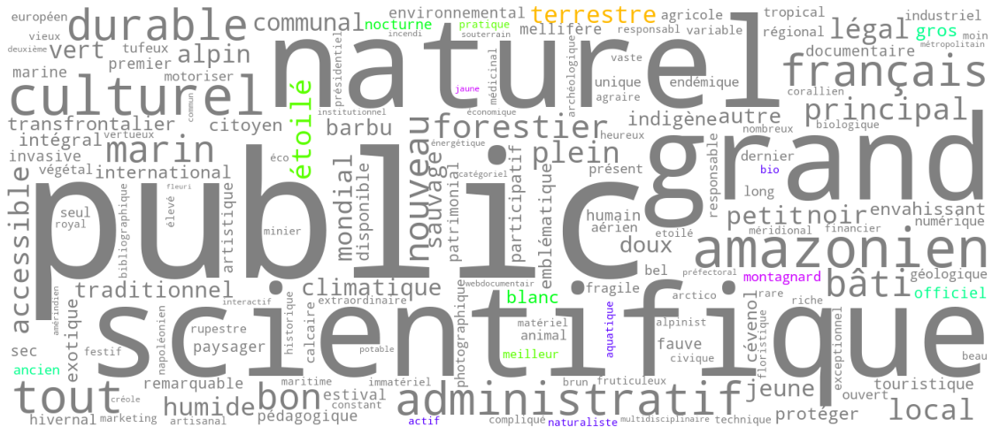

parcs ADV 109 17


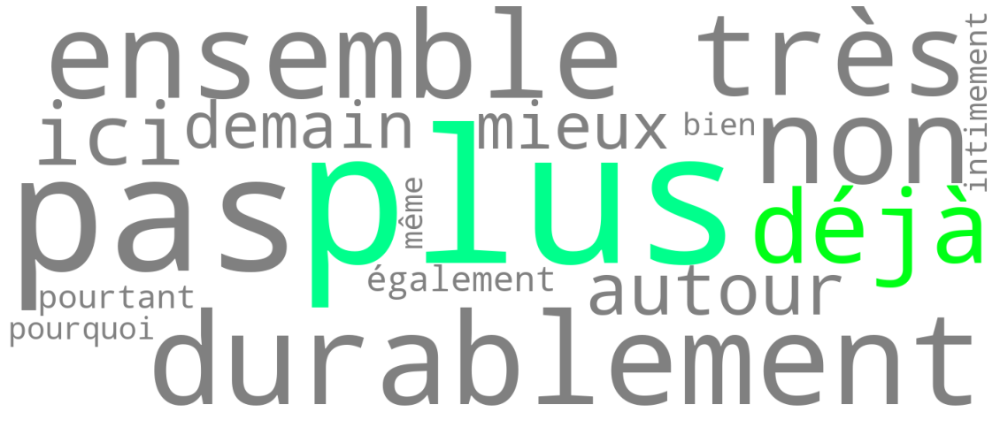

parcs NOUN 6739 539


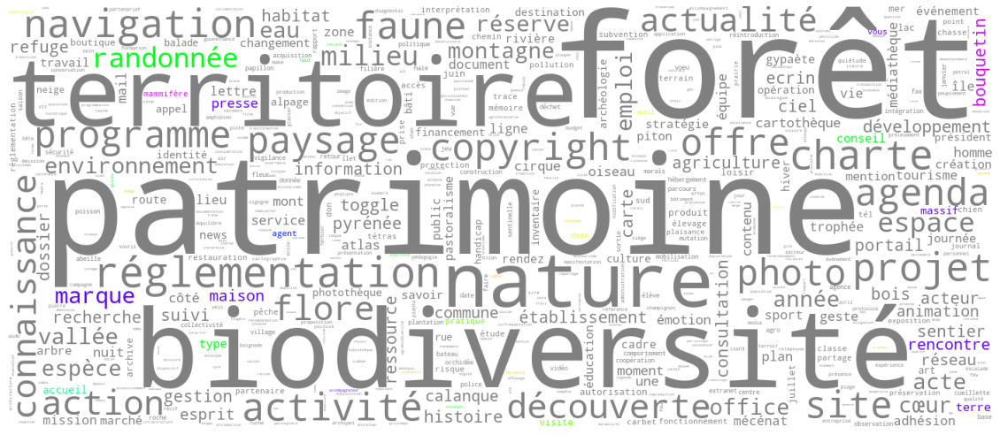

organisations VERB 1155 121


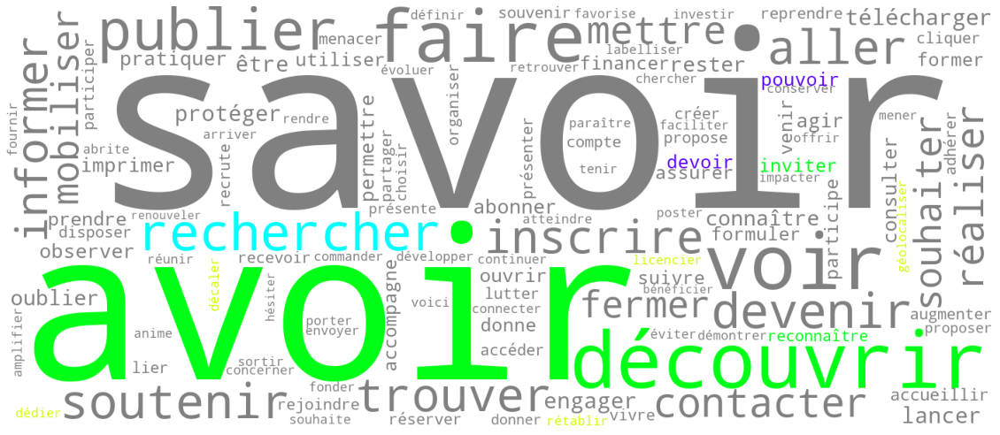

organisations ADJ 1648 151


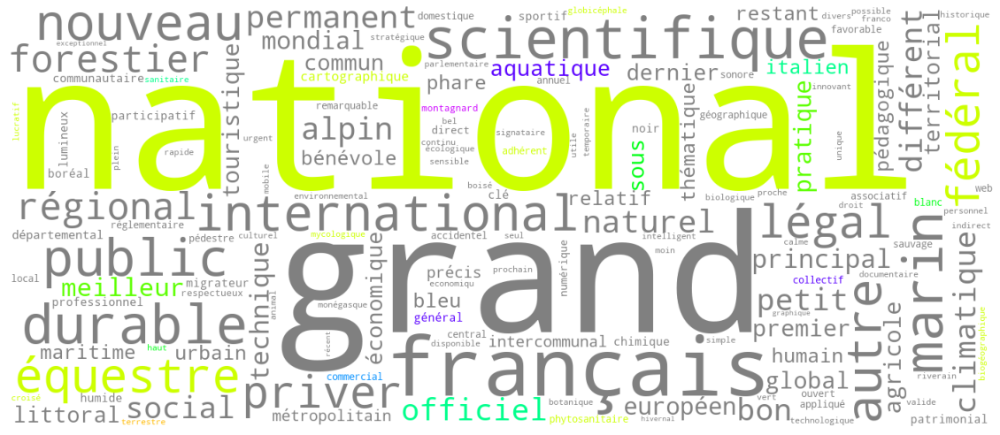

organisations ADV 142 24


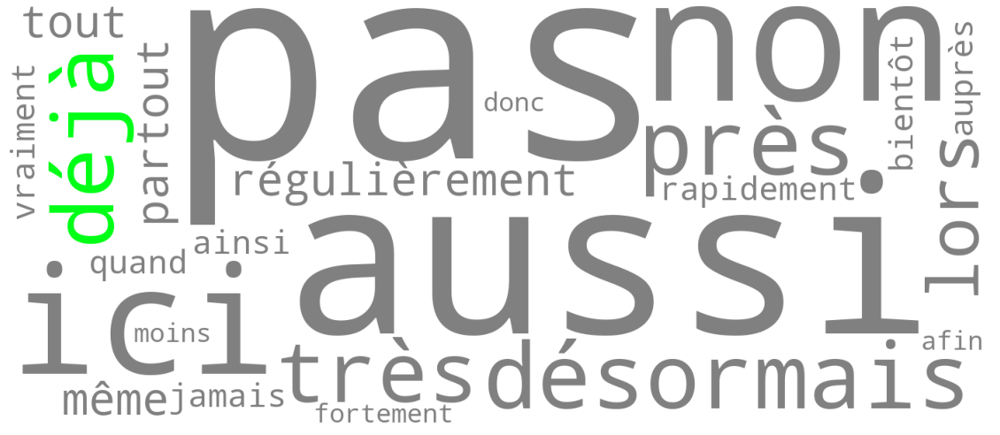

organisations NOUN 6456 573


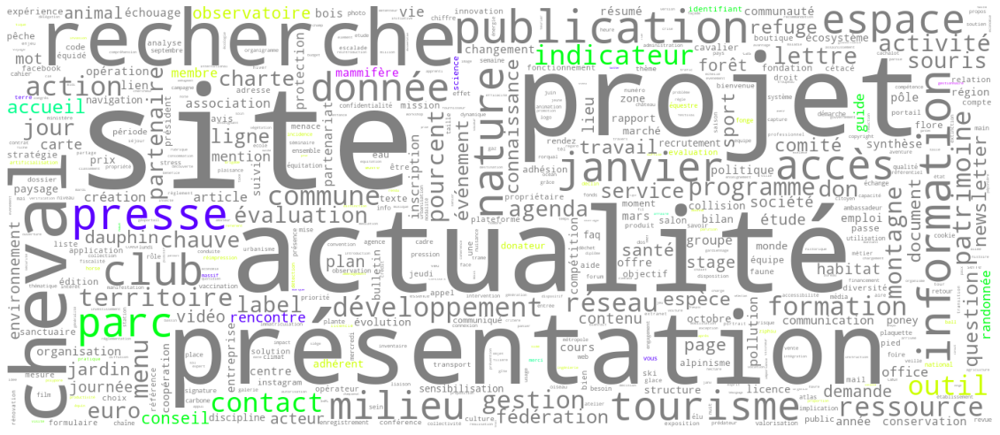

oTourism VERB 1917 154


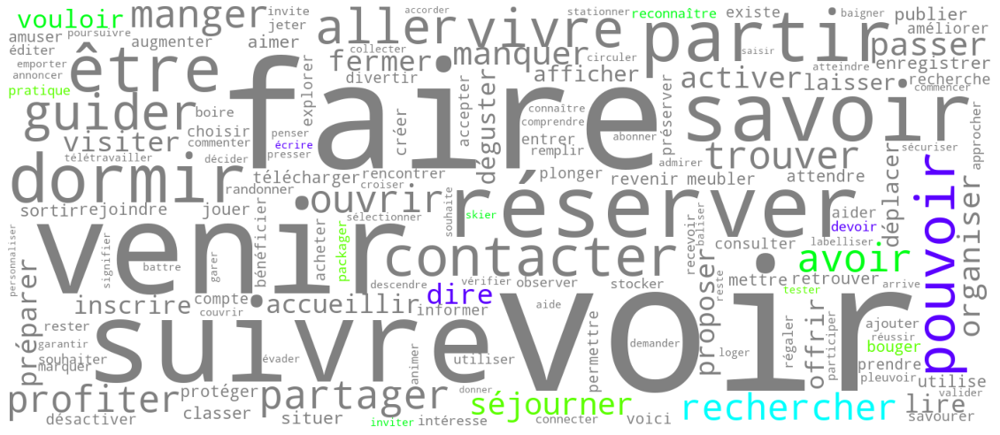

oTourism ADJ 1785 159


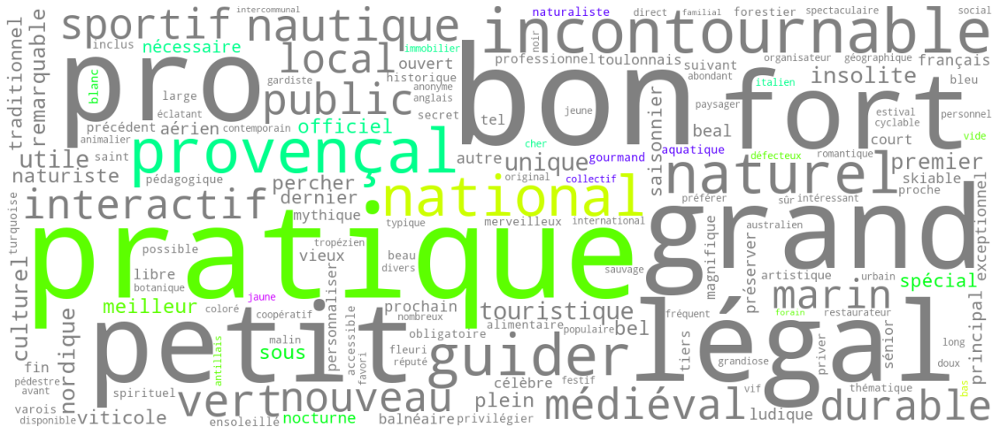

oTourism ADV 263 30


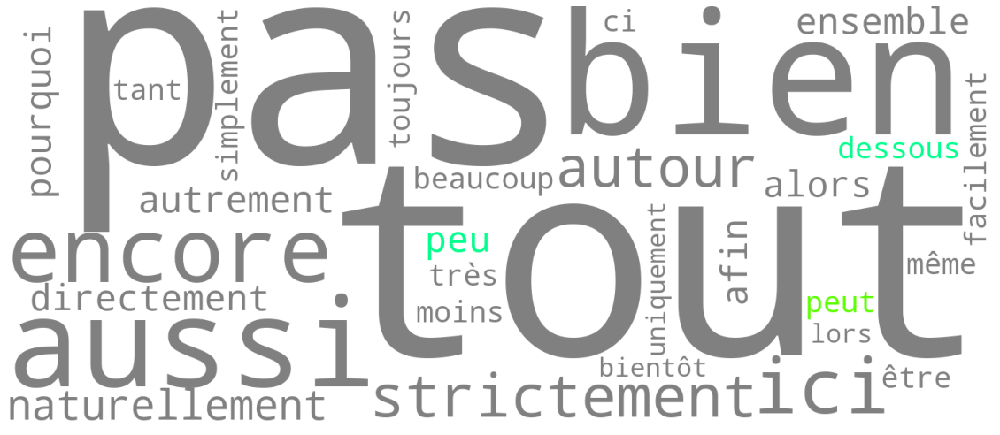

oTourism NOUN 9172 584


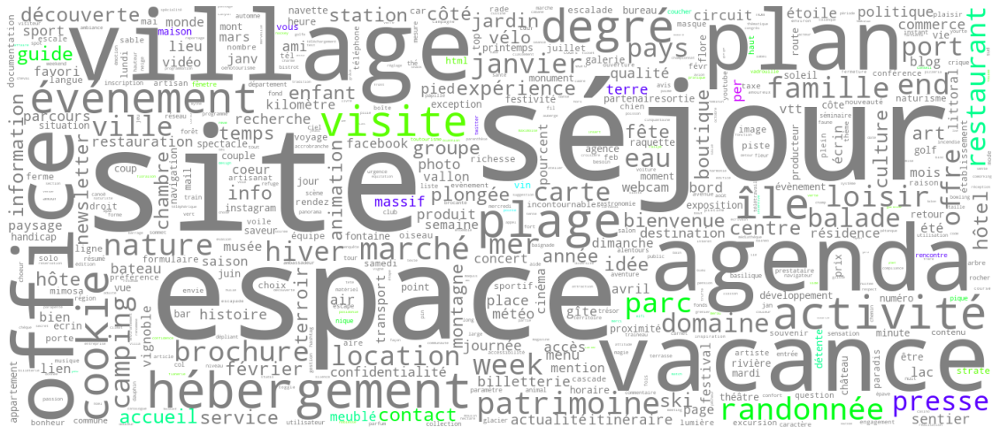

Services VERB 6222 385


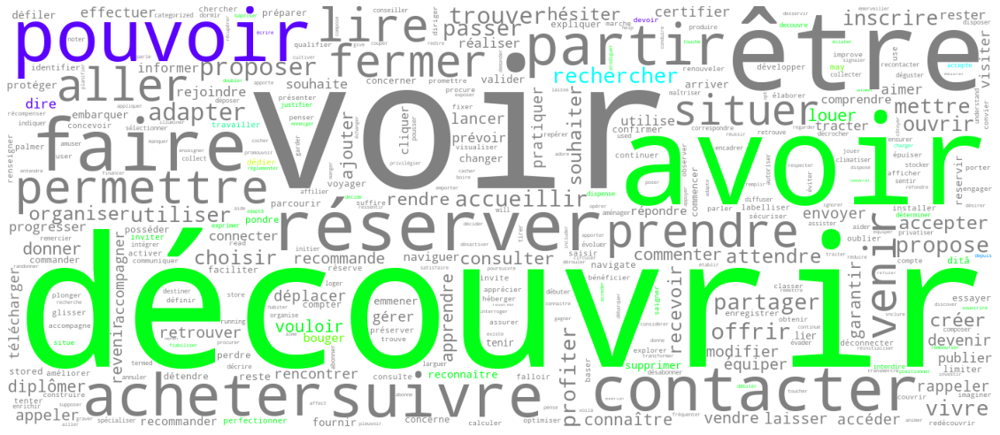

Services ADJ 5288 363


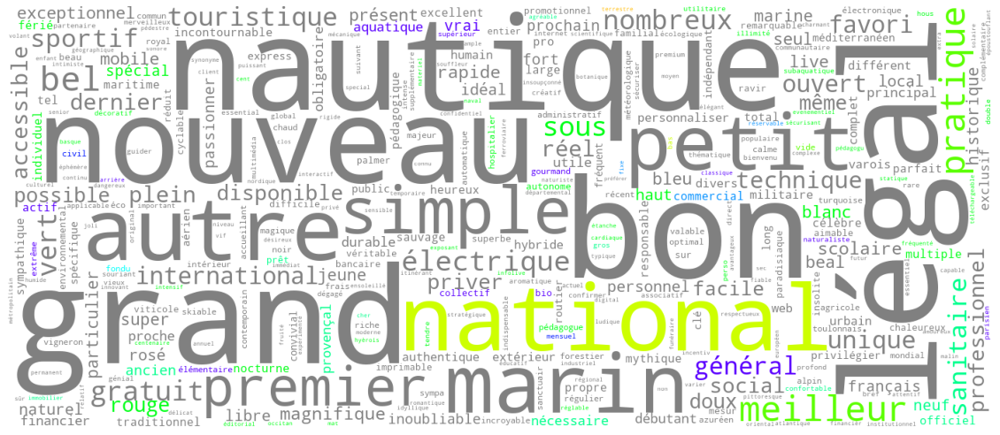

Services ADV 1547 90


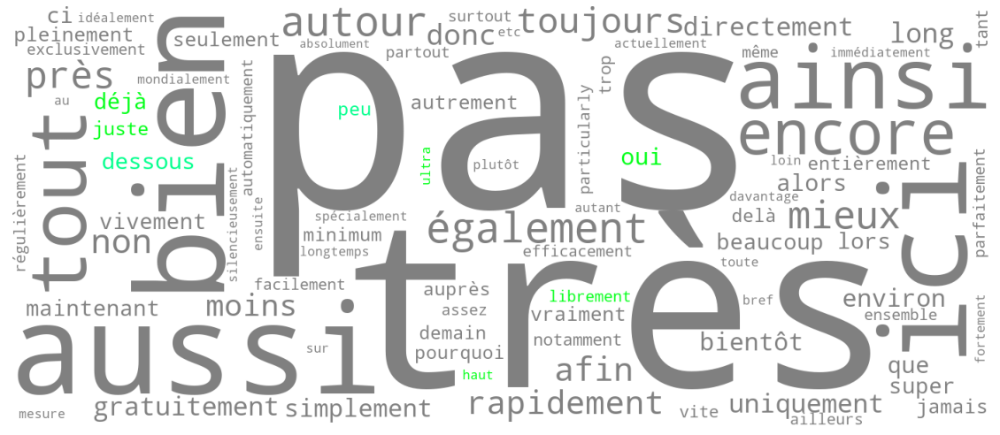

Services NOUN 28378 1421


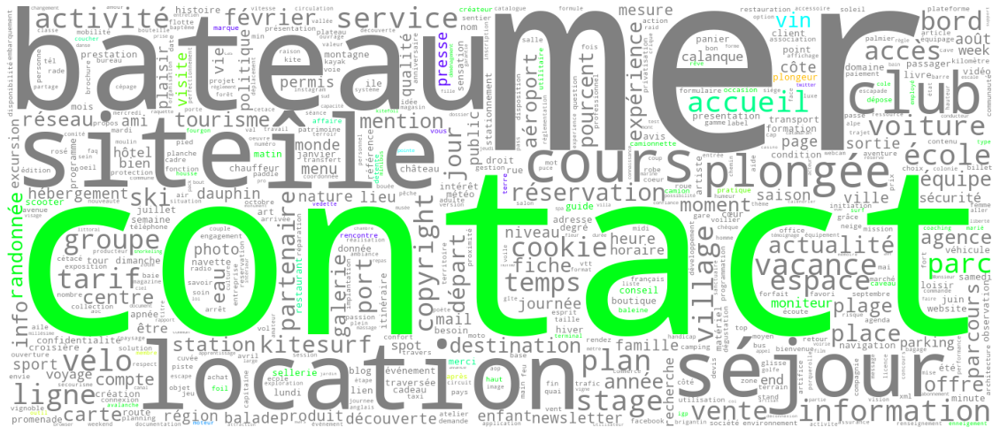

Hebergement VERB 6738 407


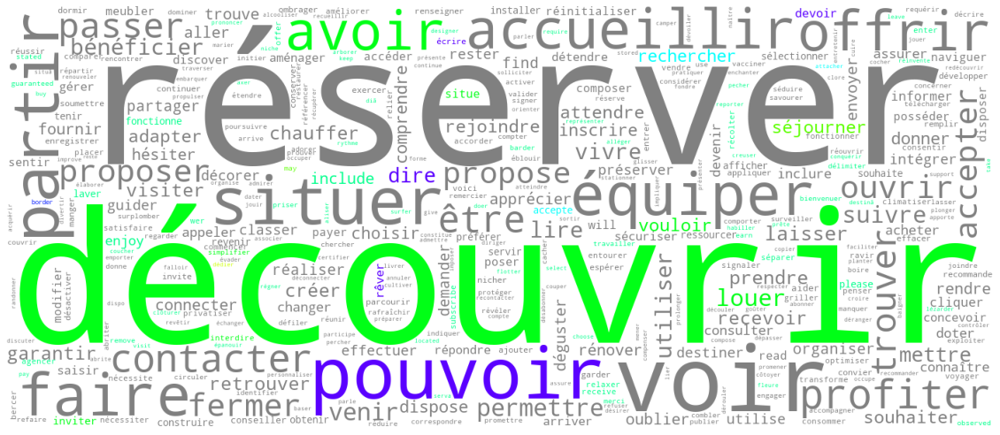

Hebergement ADJ 5747 356


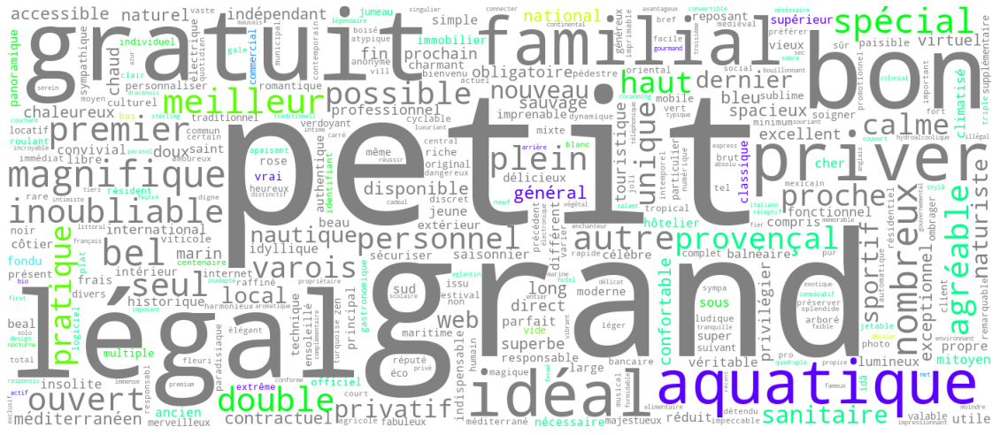

Hebergement ADV 1616 91


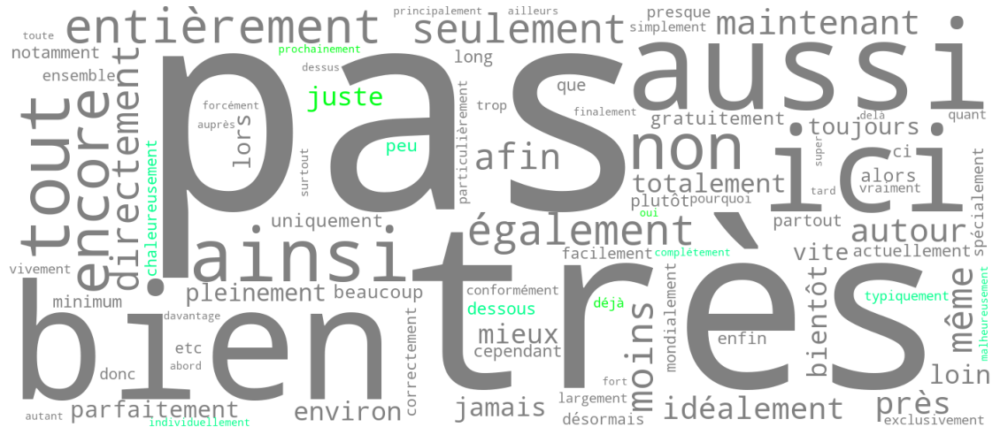

Hebergement NOUN 28359 1210


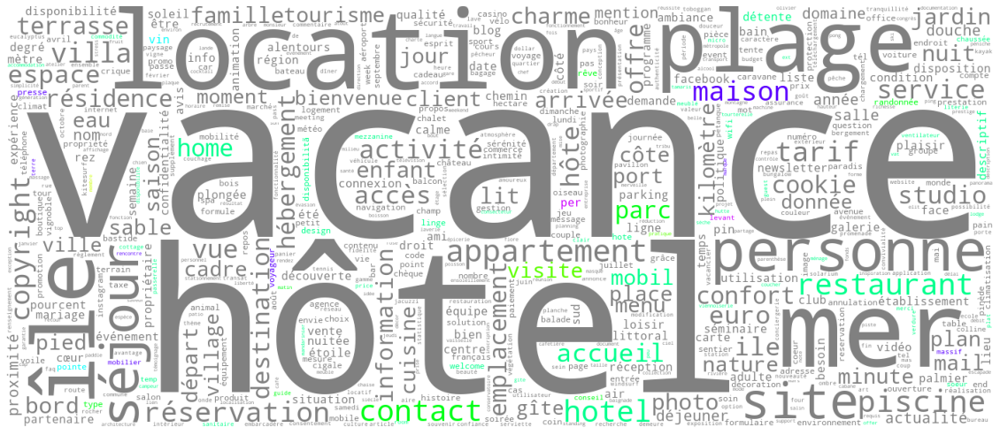

restauration VERB 874 99


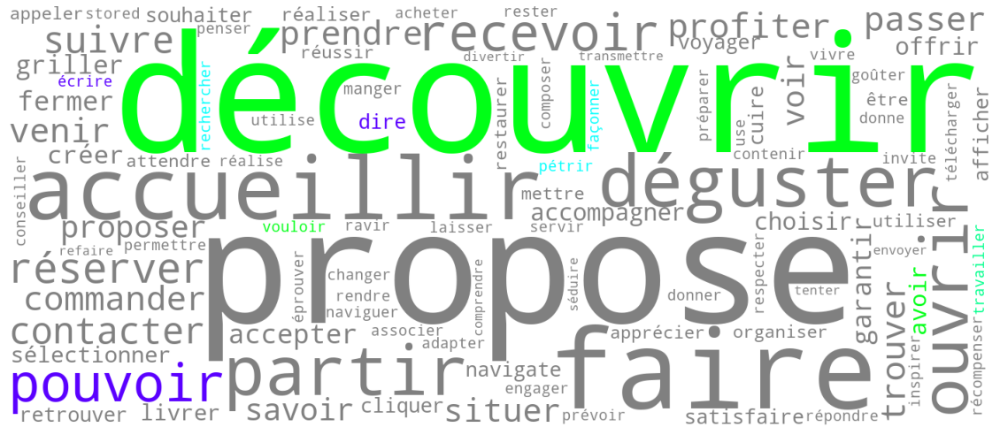

restauration ADJ 677 86


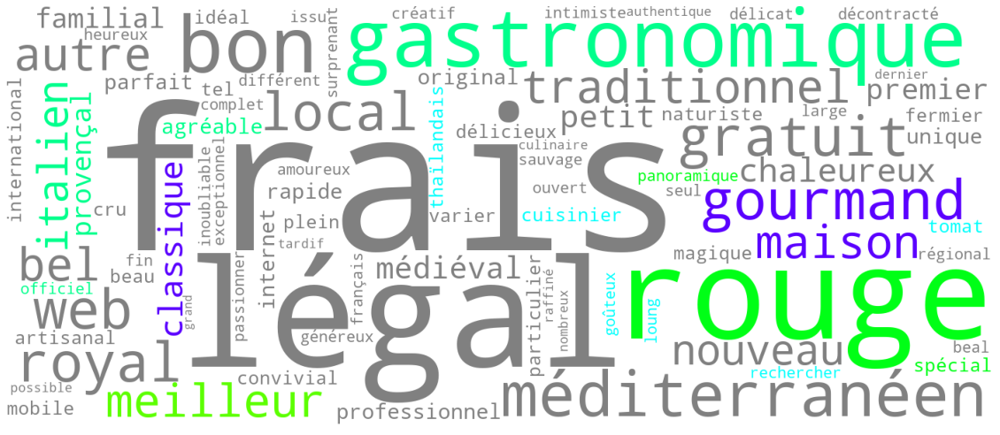

restauration ADV 186 21


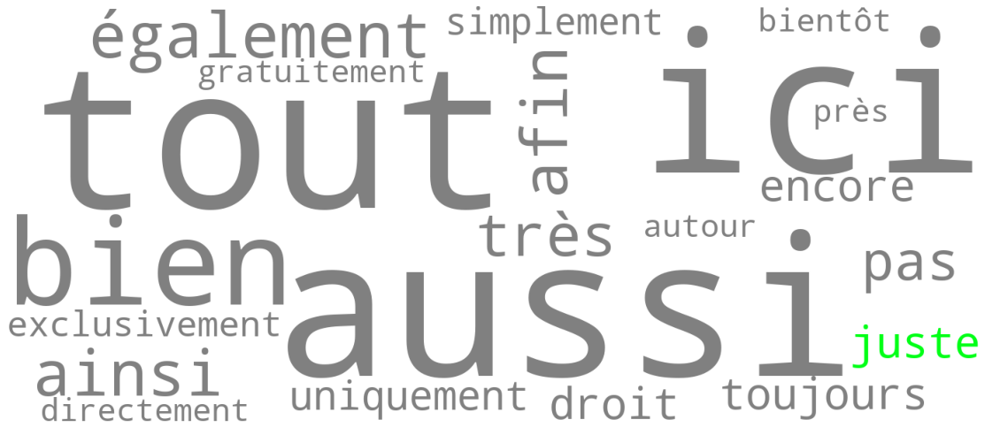

restauration NOUN 3514 322


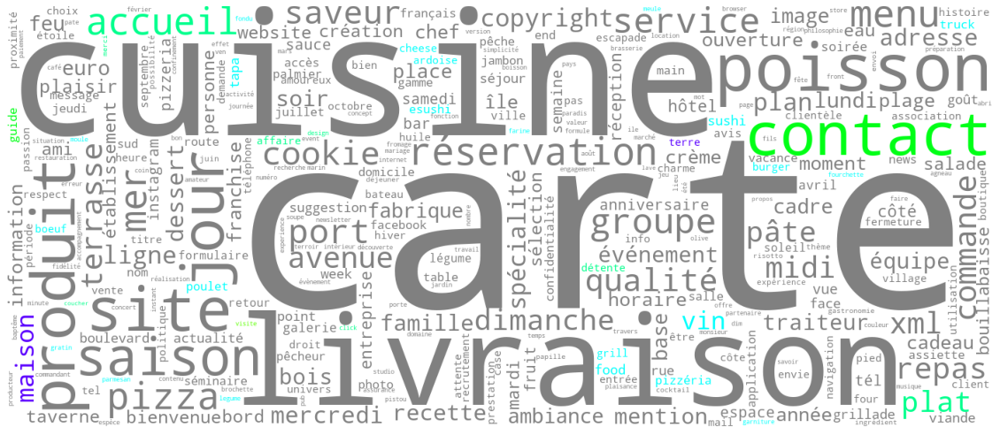

locations VERB 1747 167


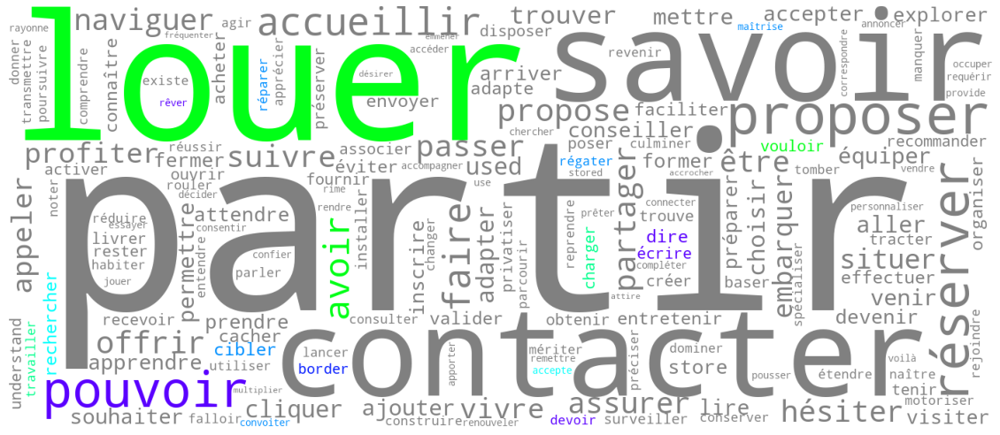

locations ADJ 1363 144


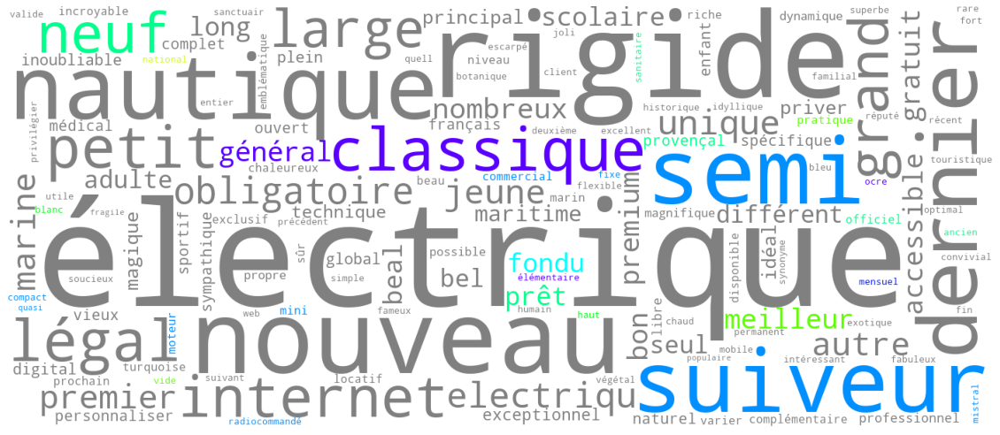

locations ADV 425 42


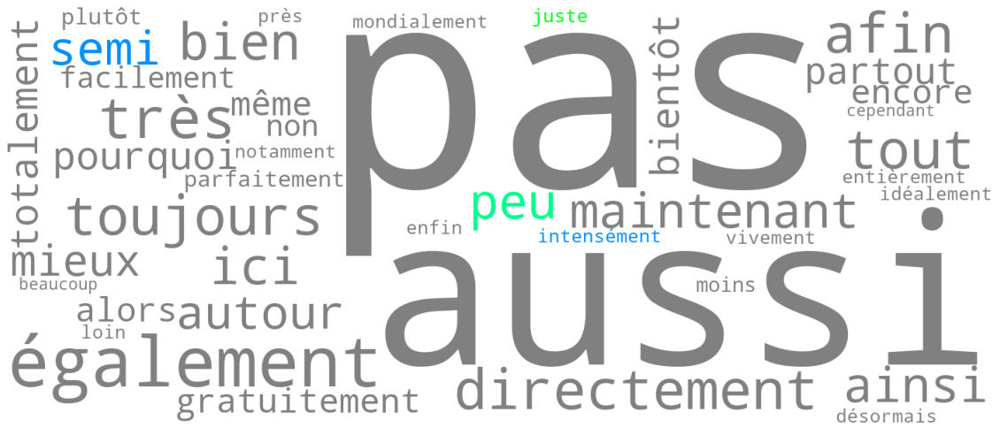

locations NOUN 8926 583


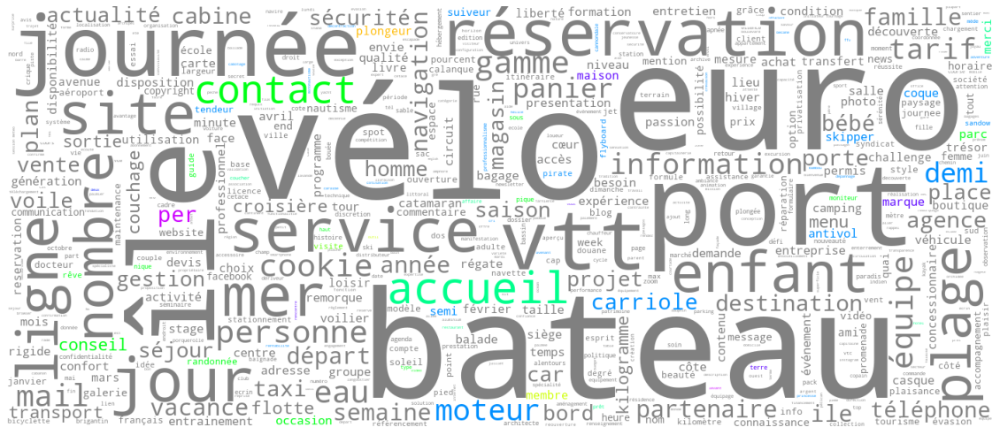

mairies VERB 241 42


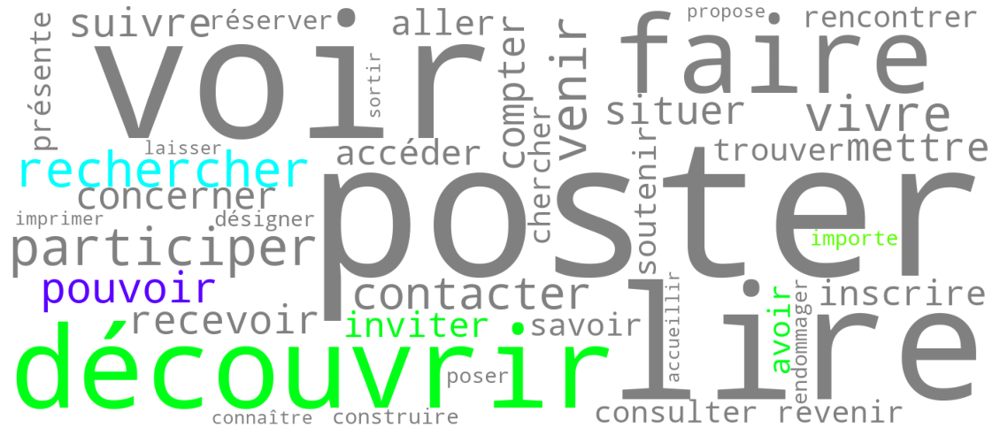

mairies ADJ 563 53


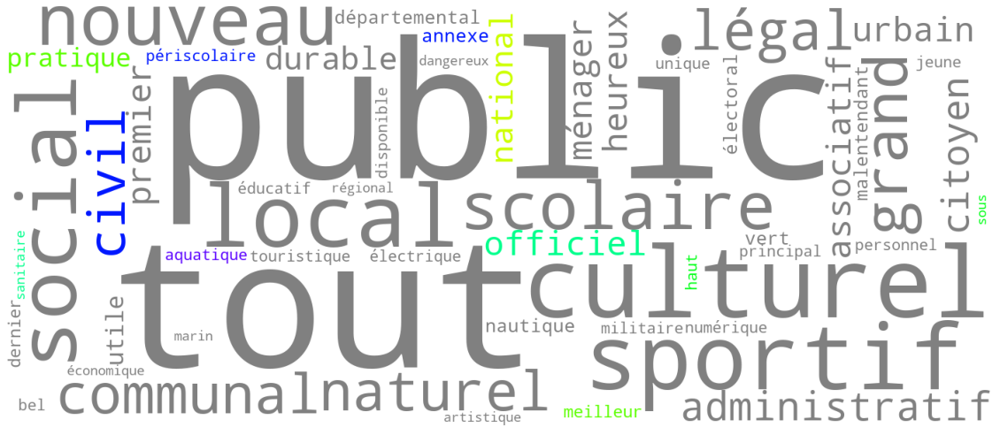

mairies ADV 19 4


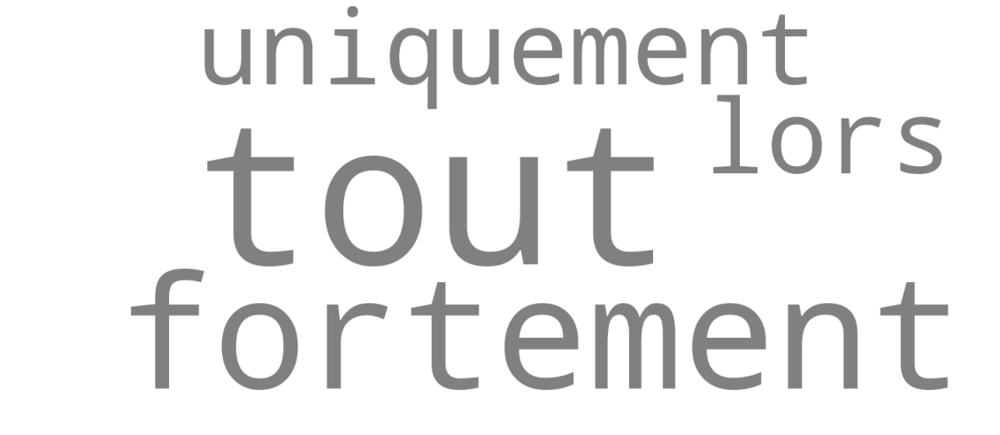

mairies NOUN 2804 332


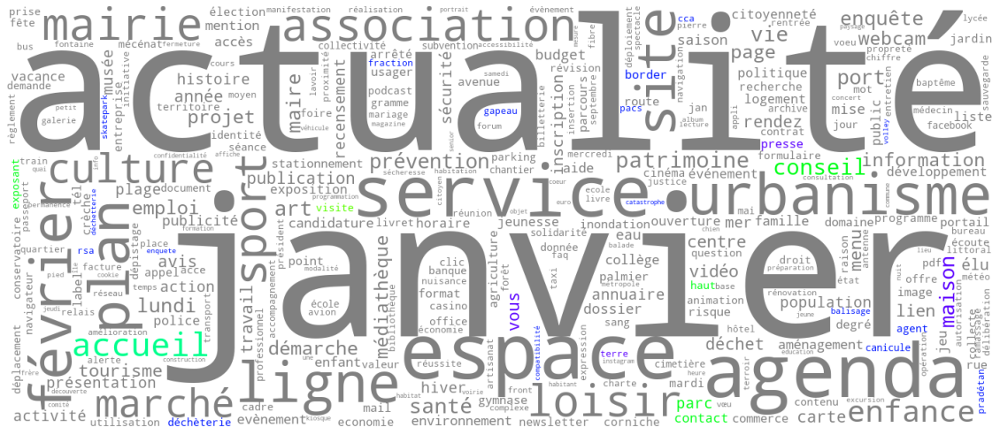

In [ ]:
tempo = dict()
seuil = 2 # occurence à partir de laquelle démarrer

for ndf in RefdicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    seuil2 = max([CountMots[ndf][cat][mot] for mot in CountMots[ndf][cat]]) #seuil
    for mot in CountMots[ndf][cat].keys():
      if CountMots[ndf][cat][mot] >seuil and CountMots[ndf][cat][mot] <seuil2 and clean2(mot, aExclure):
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    makeImage(tempo[cat], palette, couleursMots)

## Représentations sur les mots exclusifs de la catégorie

In [ ]:
aExclure += ['enjoy', 'find', 'html', 'tag', 'insert','november', 'svg', 'vsc', 'pnc', 'pag', 'anr','par', 'inselberg', 'servã', "discover", "allow", "logged", 'include', 'offer', 'receive', 'please', 'guaranteed', 'visit', 'pay', 'keep', 'submit', 'stay', 'remove', 'enter', 'emitted', 'authenticate', 'see', 'rès', 'xvi', 'xix', 'border', "per", "app", "disabl", "png", "xvii", 'est' ]
aExclure += ['wer', "chosen", 'turn', 'build', 'back', "diã", "observed", "save", "animã", "amã", "destinã", 'visited', 'furnished', 'gue', "saved", "try", "enter"]

Gouv VERB 26 9


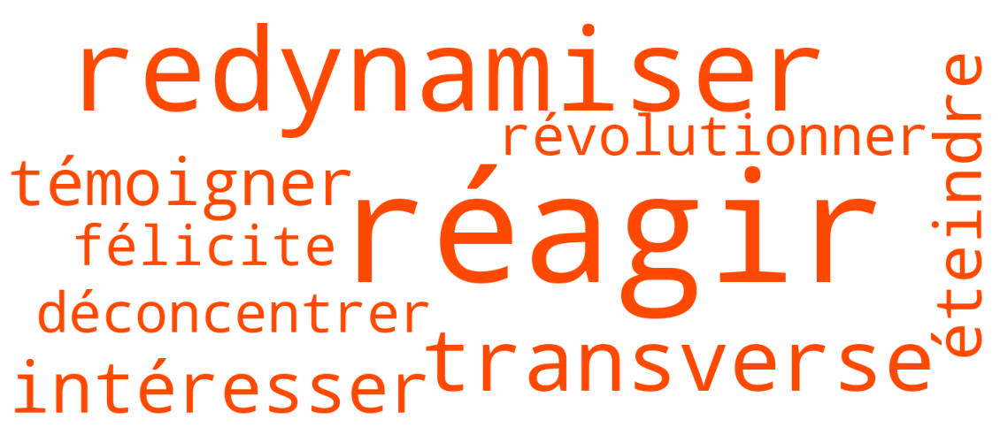

Gouv ADJ 83 29


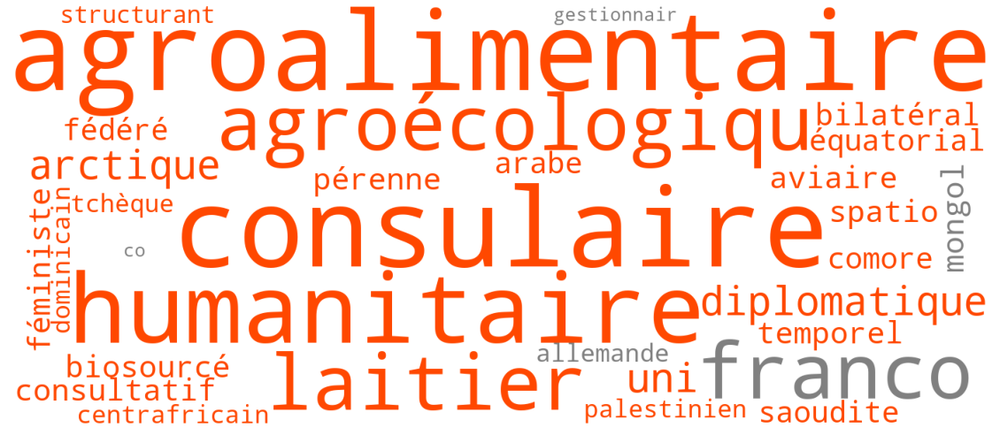

Gouv ADV 0 0
vide
Gouv NOUN 197 62


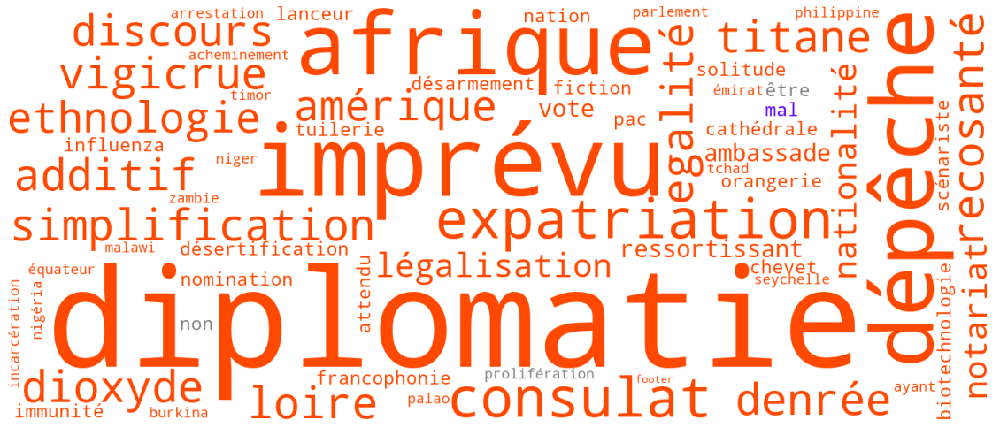

parcs VERB 0 0
vide
parcs ADJ 14 7


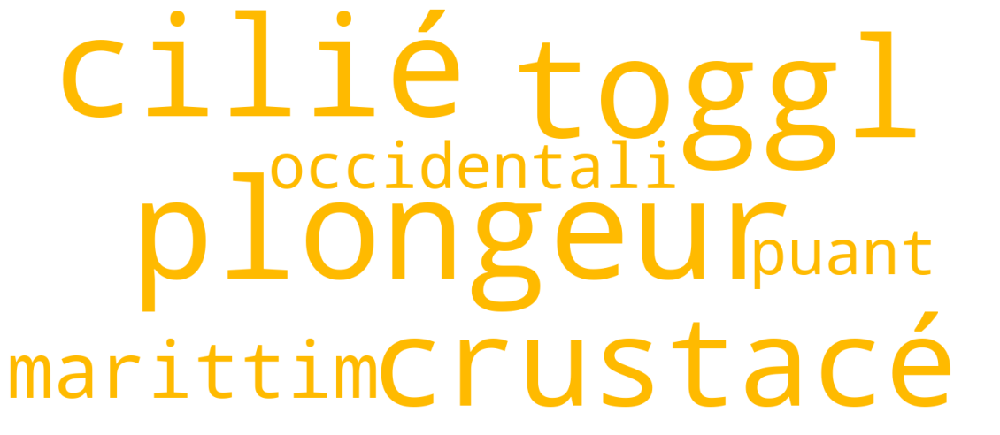

parcs ADV 0 0
vide
parcs NOUN 66 29


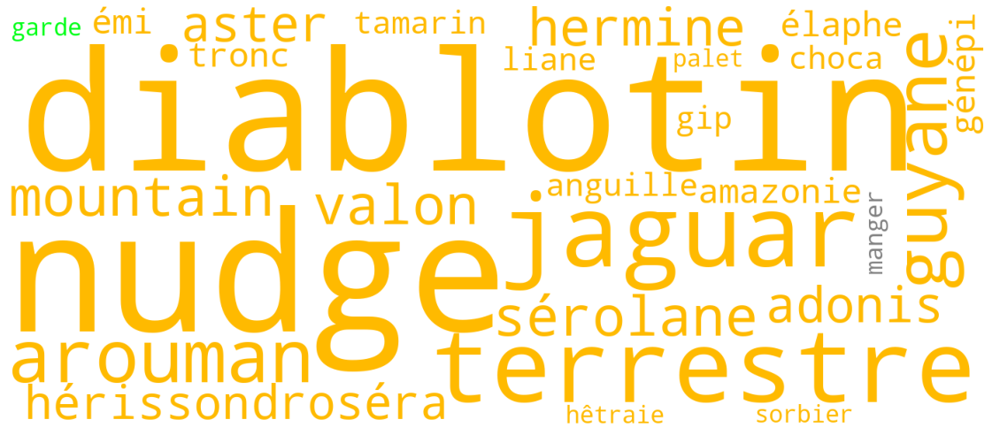

organisations VERB 72 33


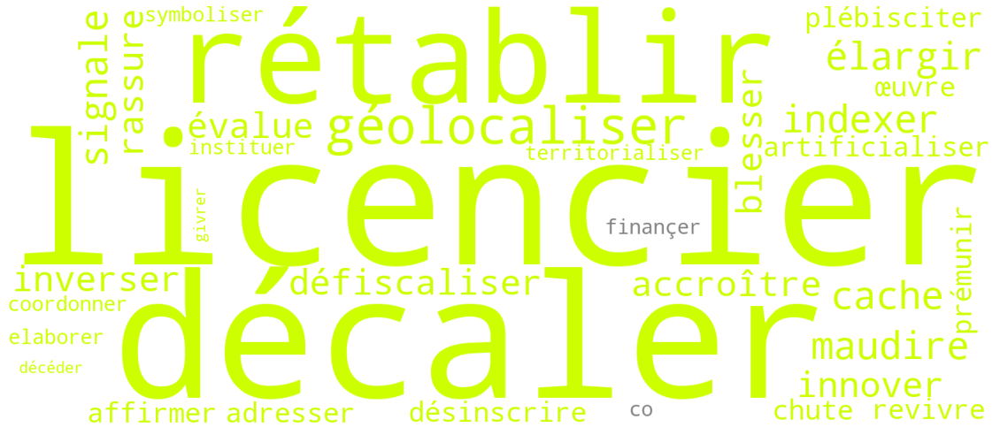

organisations ADJ 162 56


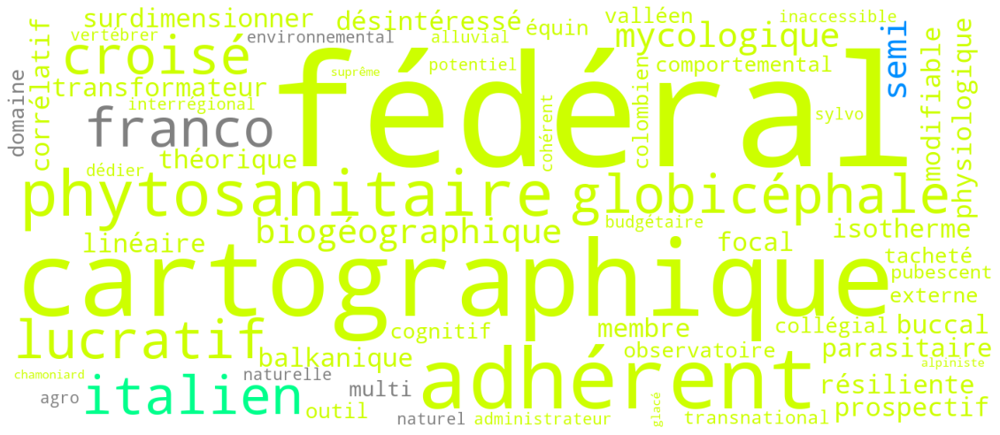

organisations ADV 8 4


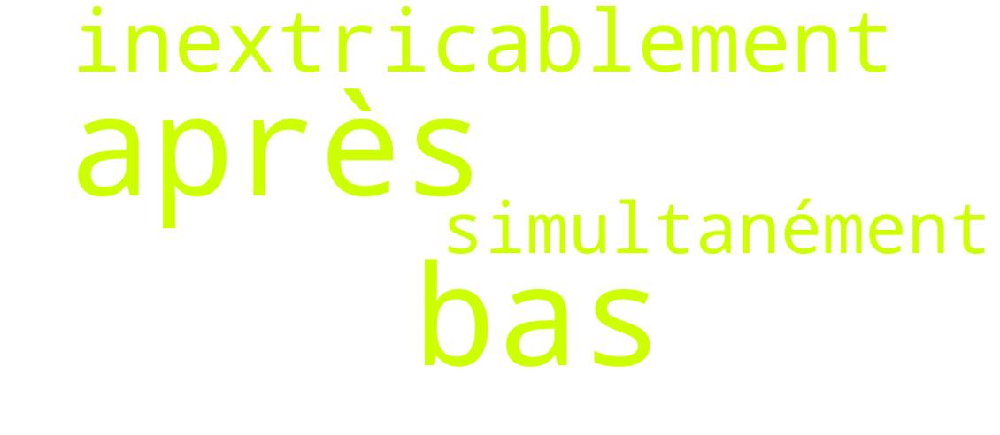

organisations NOUN 382 145


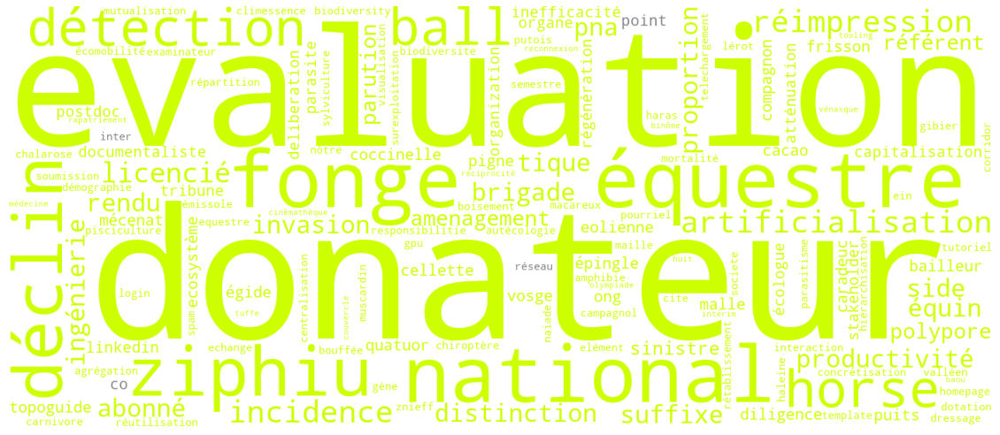

oTourism VERB 63 28


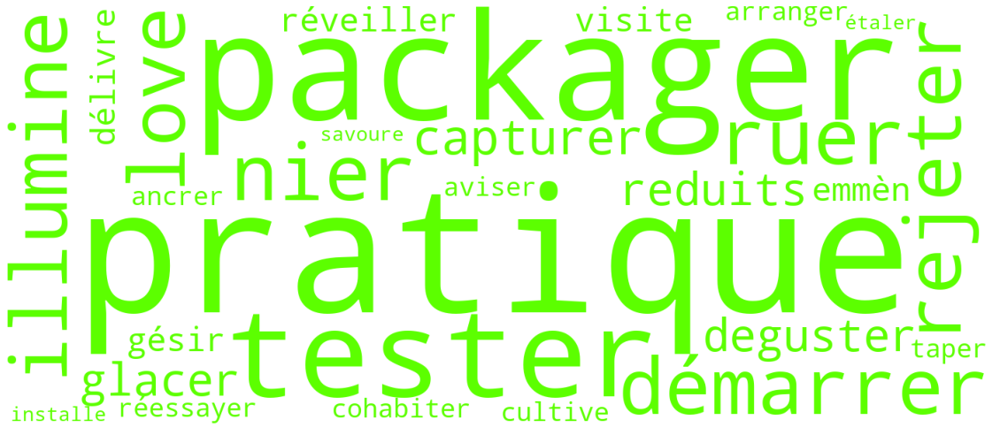

oTourism ADJ 69 33


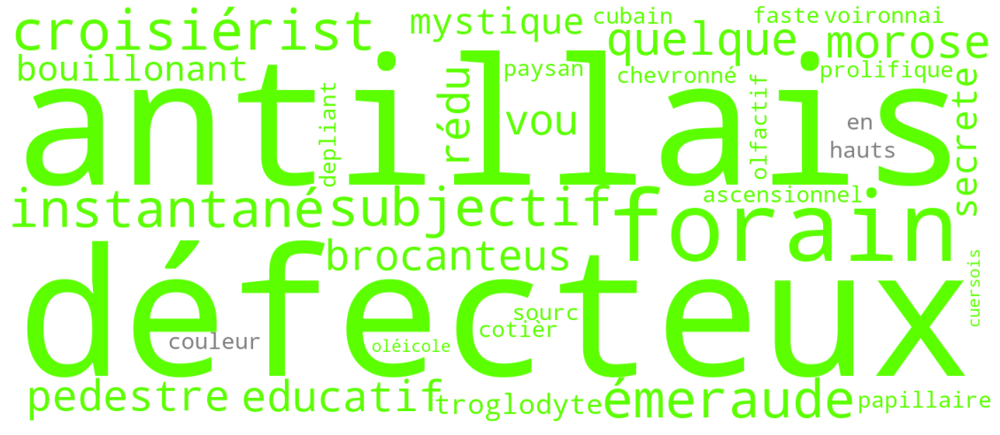

oTourism ADV 10 4


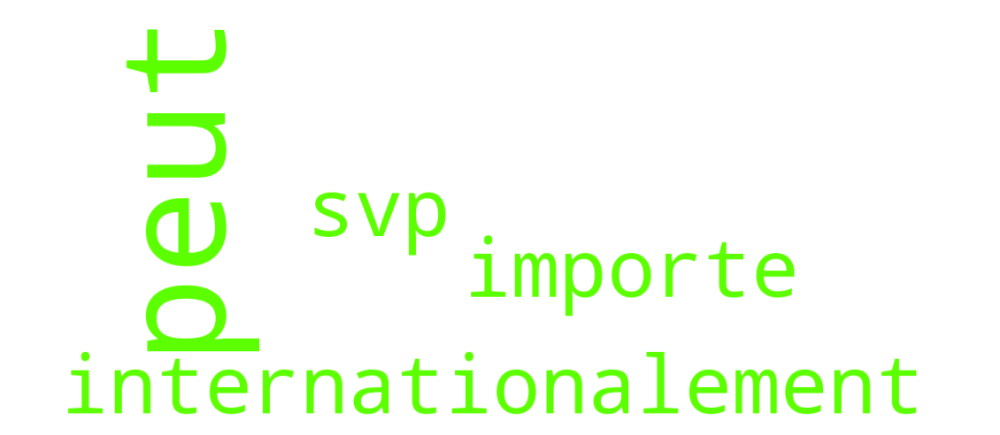

oTourism NOUN 271 111


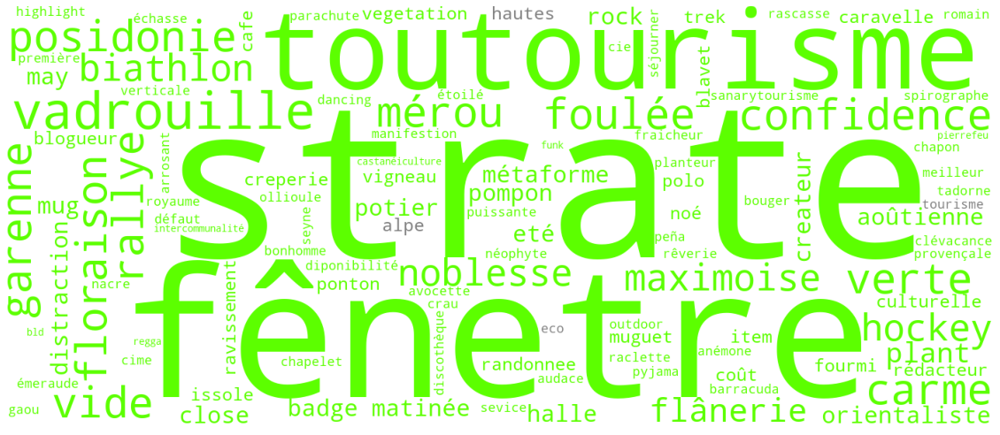

Services VERB 445 174


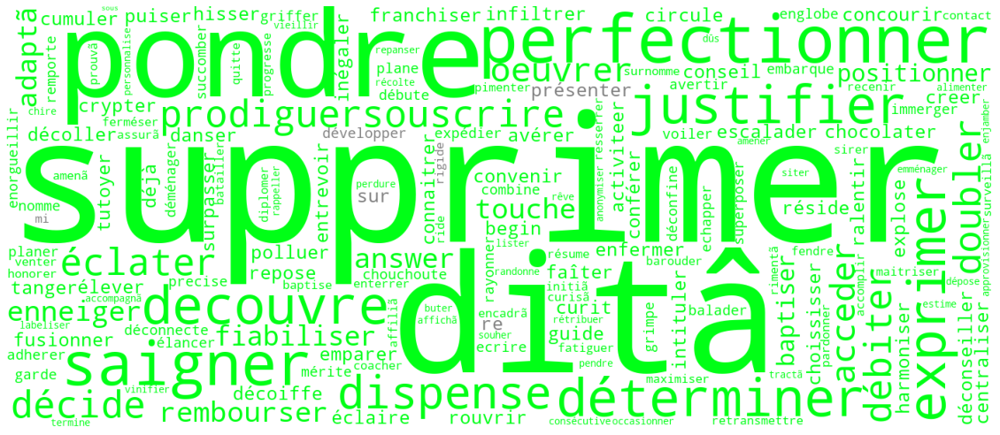

Services ADJ 427 172


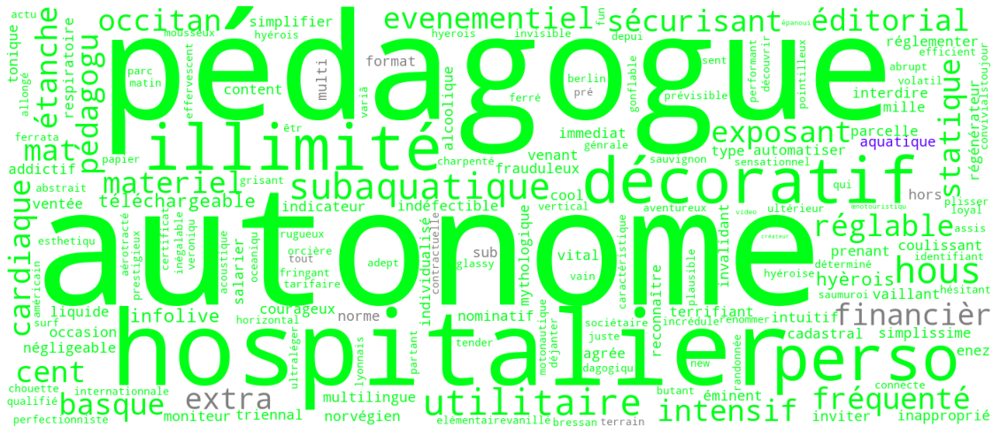

Services ADV 69 31


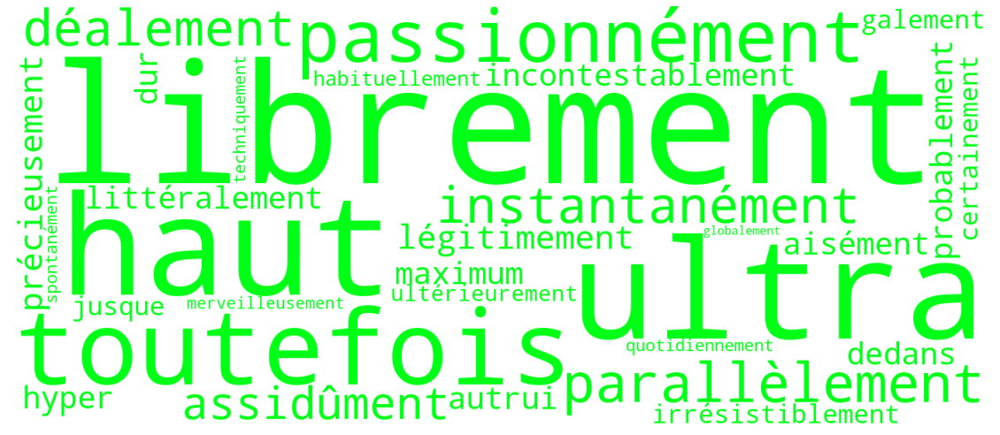

Services NOUN 1959 551


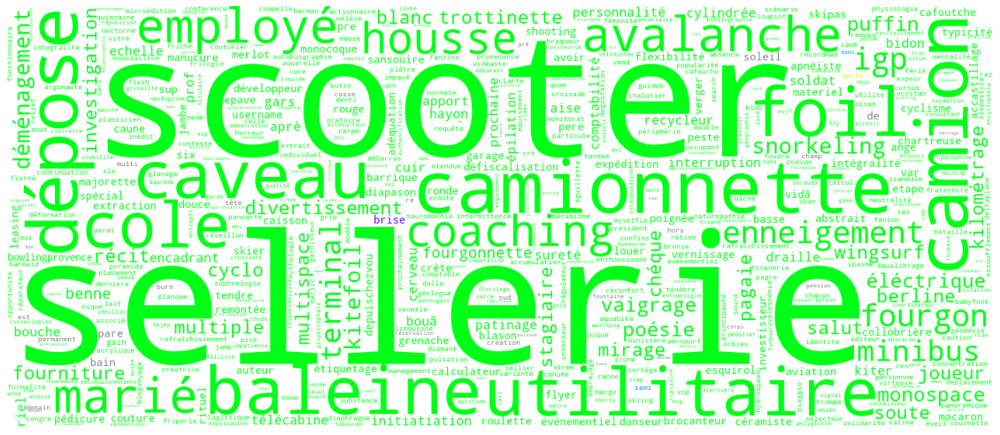

Hebergement VERB 516 188


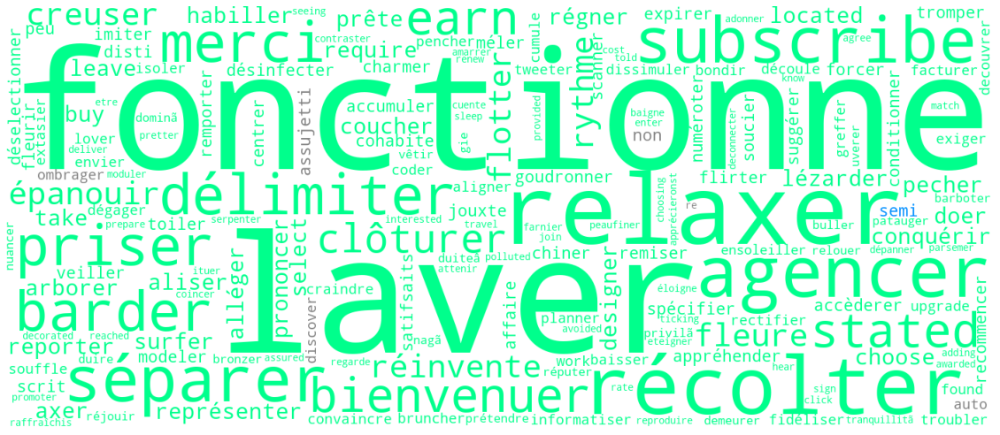

Hebergement ADJ 460 147


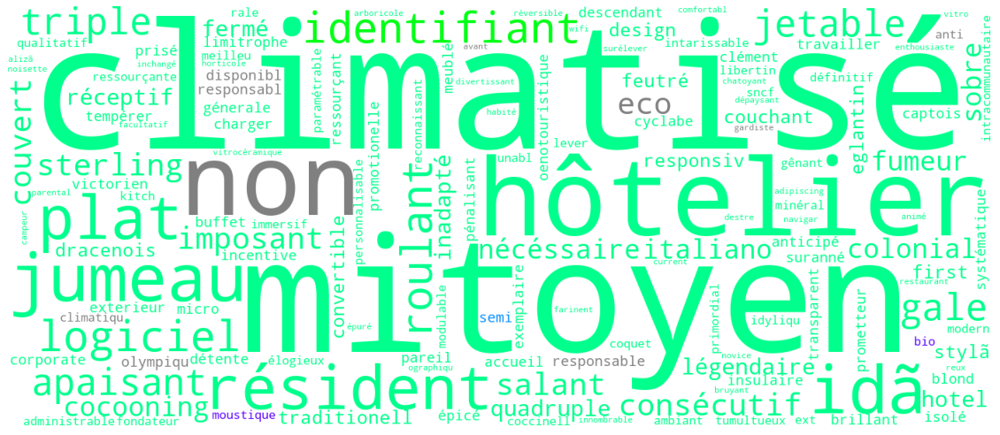

Hebergement ADV 79 32


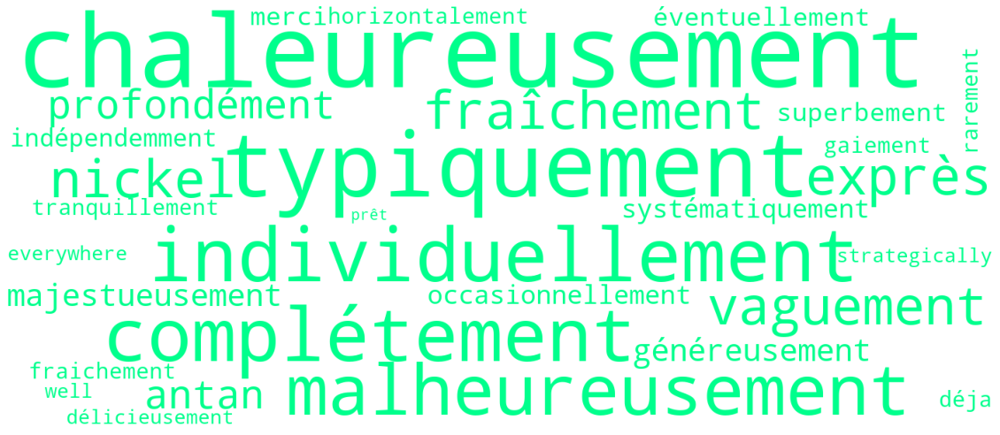

Hebergement NOUN 2096 492


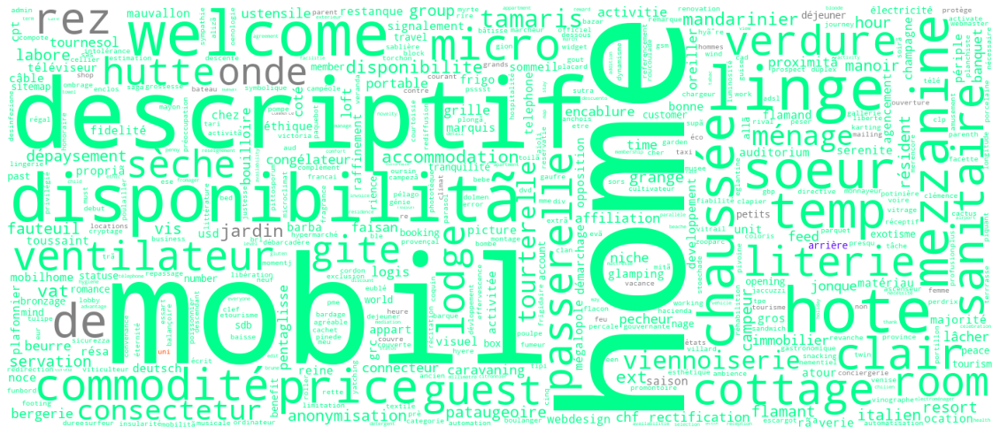

restauration VERB 53 25


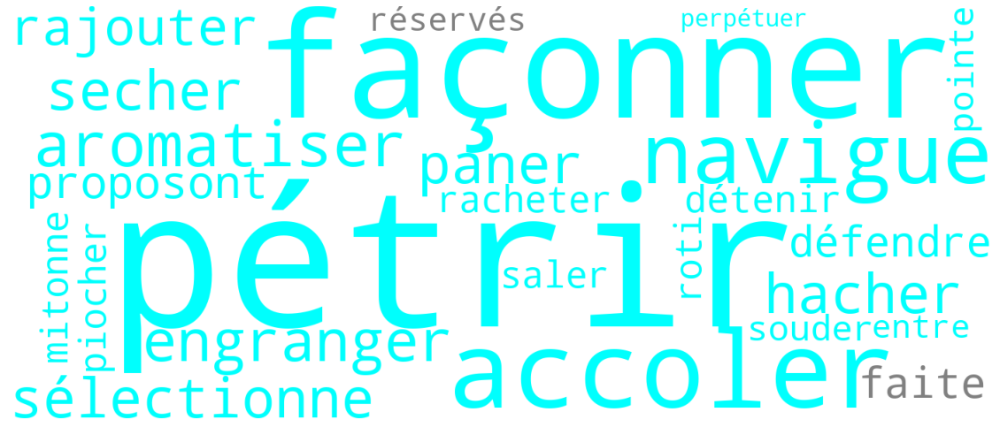

restauration ADJ 70 26


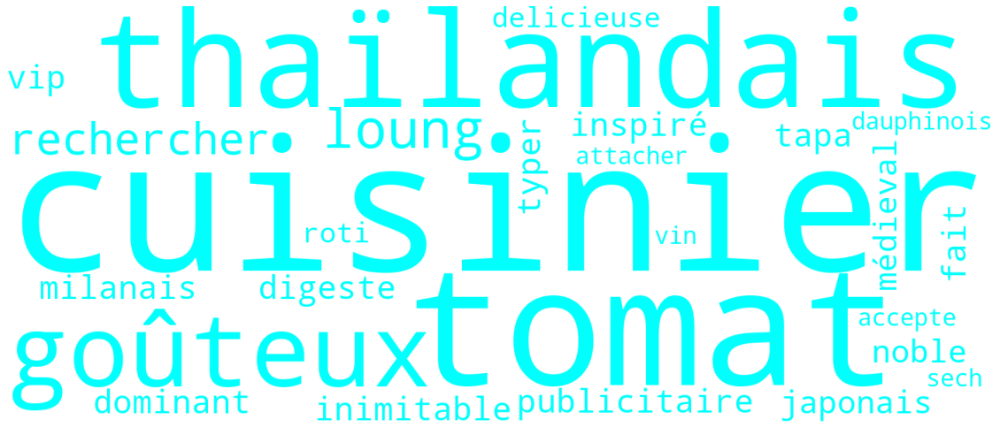

restauration ADV 8 4


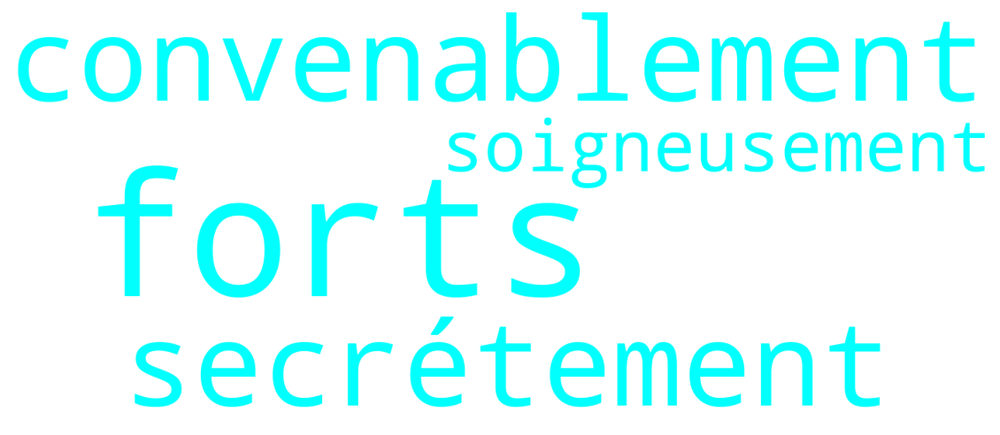

restauration NOUN 267 98


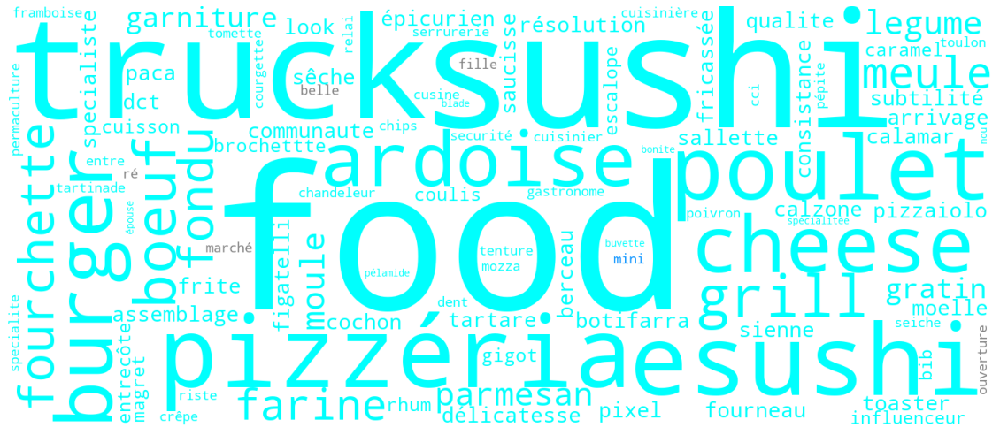

locations VERB 78 32


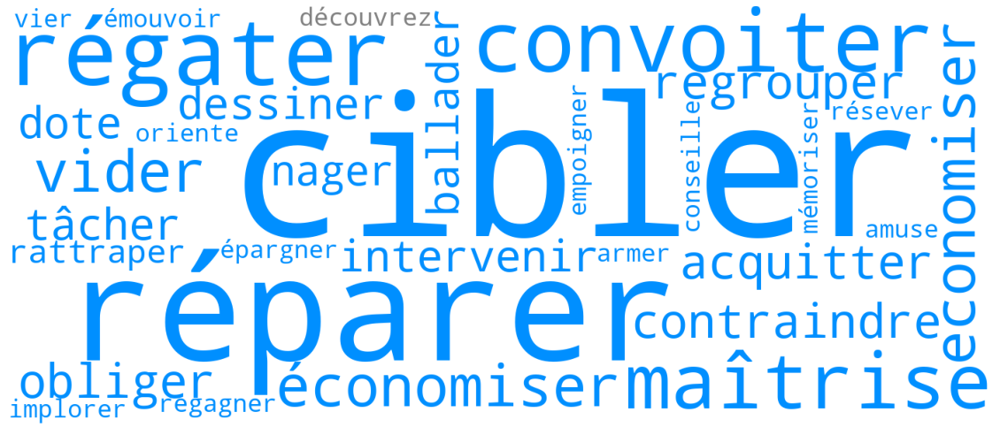

locations ADJ 117 37


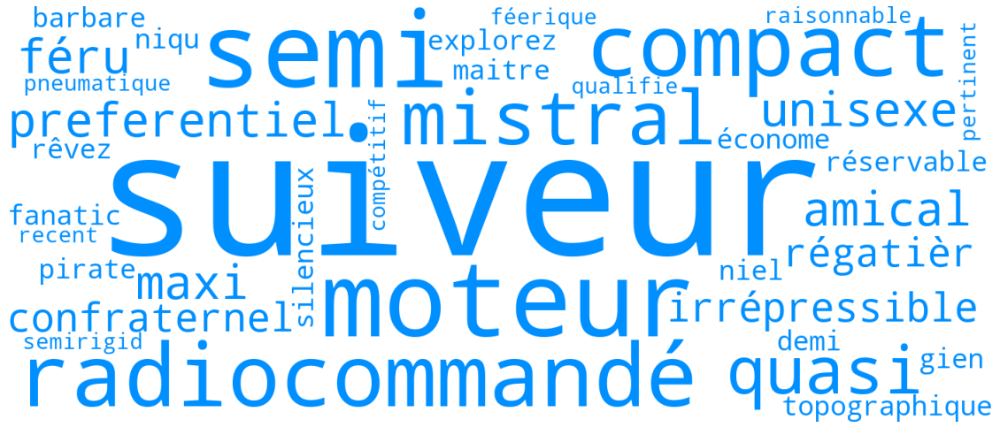

locations ADV 10 4


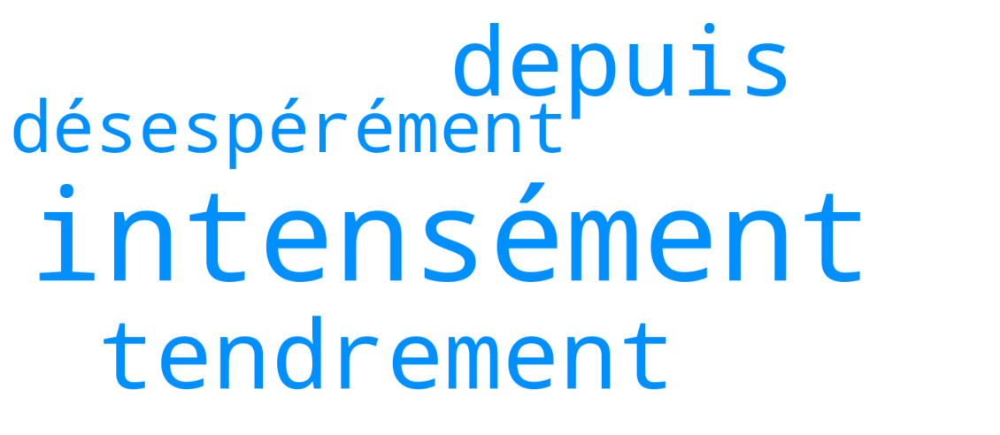

locations NOUN 409 112


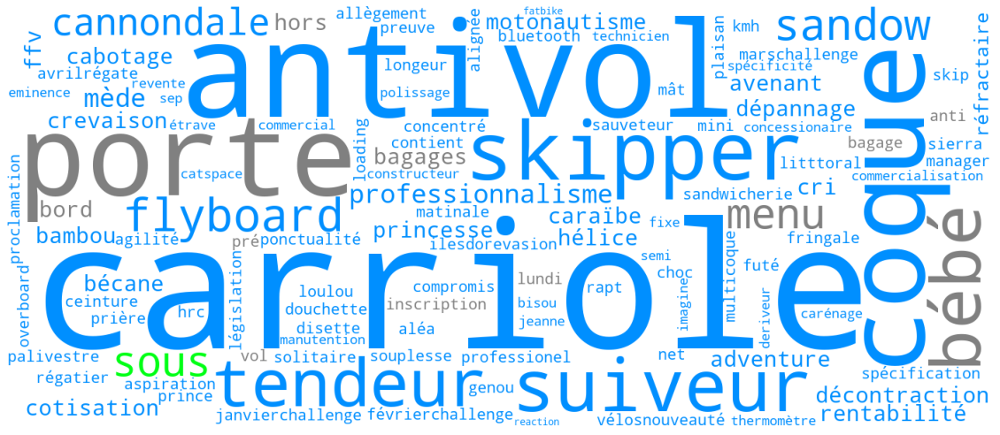

mairies VERB 13 7


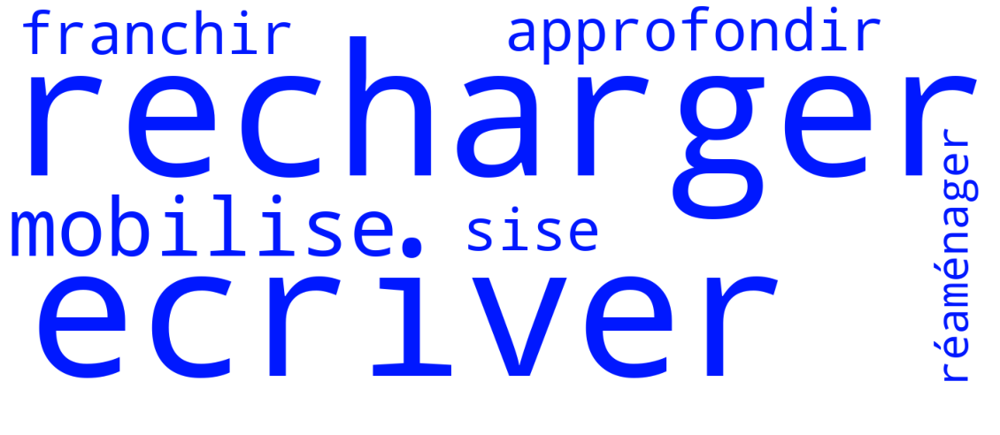

mairies ADJ 47 24


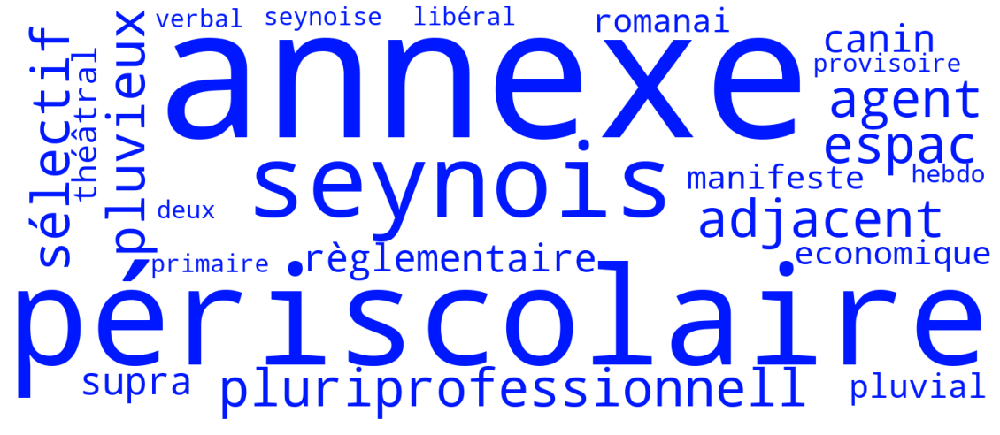

mairies ADV 2 1


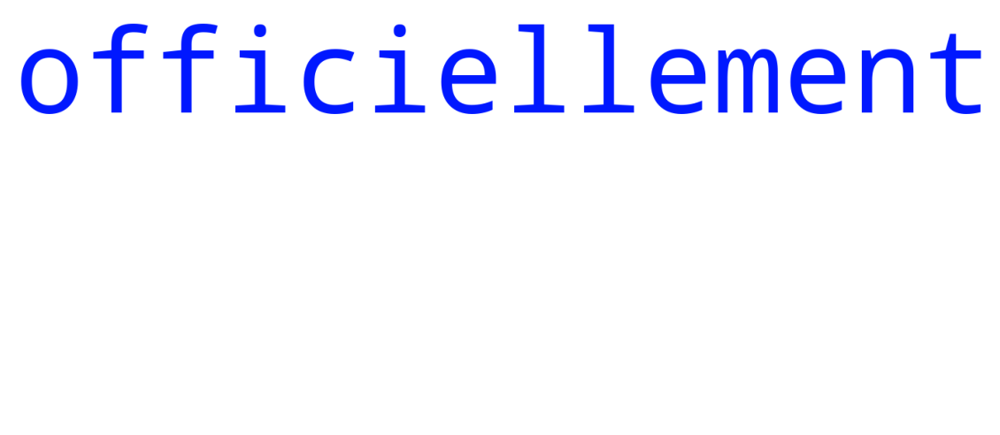

mairies NOUN 153 64


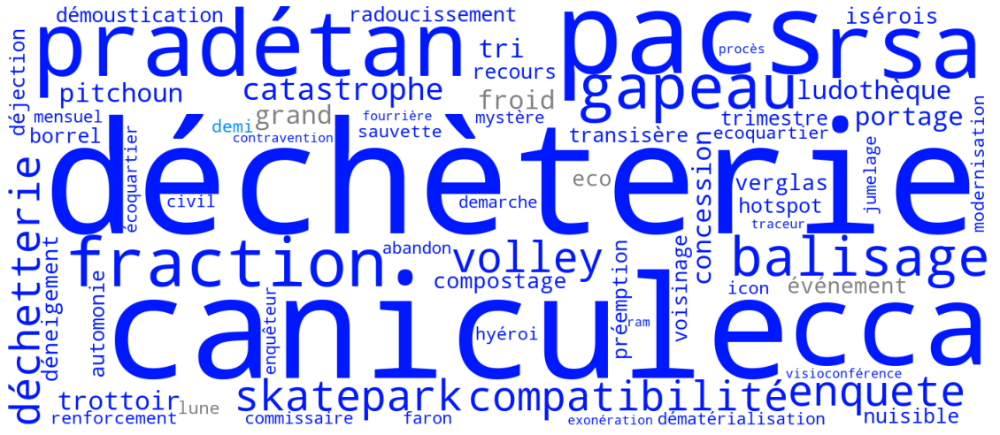

In [ ]:
tempo = dict()
seuil = 0 # occurence à partir de laquelle démarrer
for ndf in RefdicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    for mot in CountMots[ndf][cat].keys():
      if CountMots[ndf][cat][mot] >seuil  and mot in diff[ndf][cat] and clean2(mot, aExclure):
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    if len(tempo[cat])>0:
      makeImage(tempo[cat], palette, couleursMots)
    else:
      print ('vide')

## Représentations mixant plusieurs catégories de sites

VERB
ADJ
ADV
NOUN


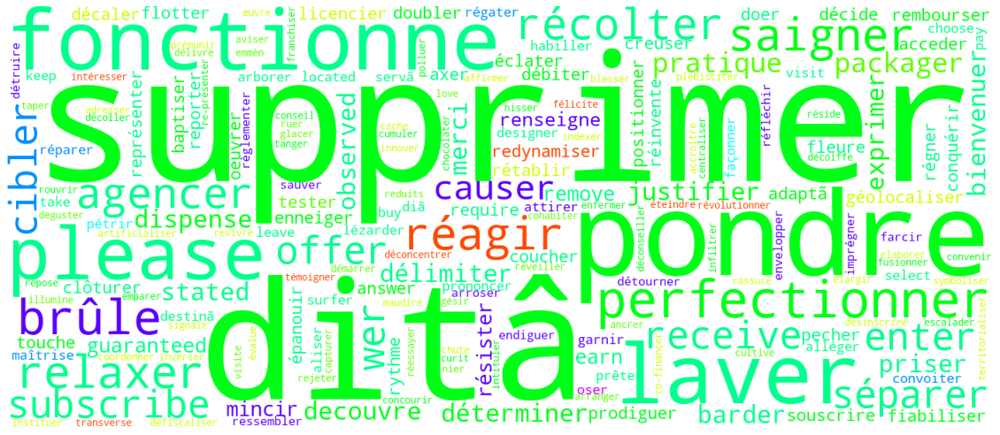

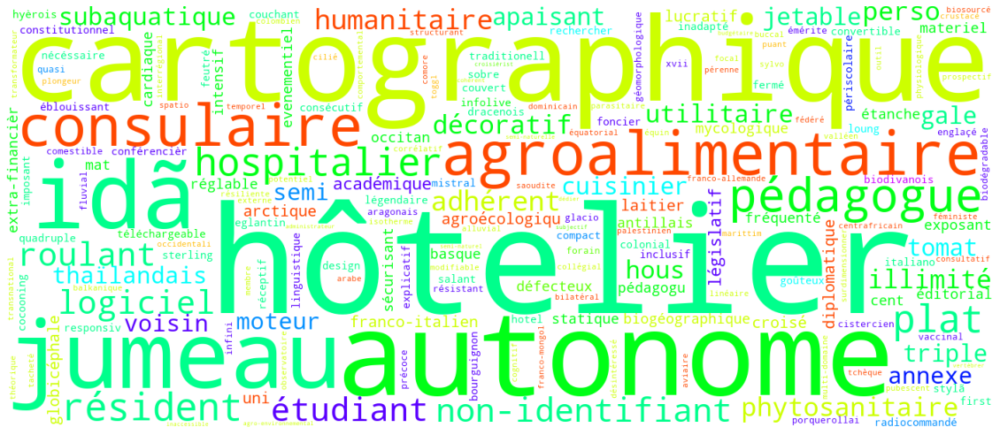

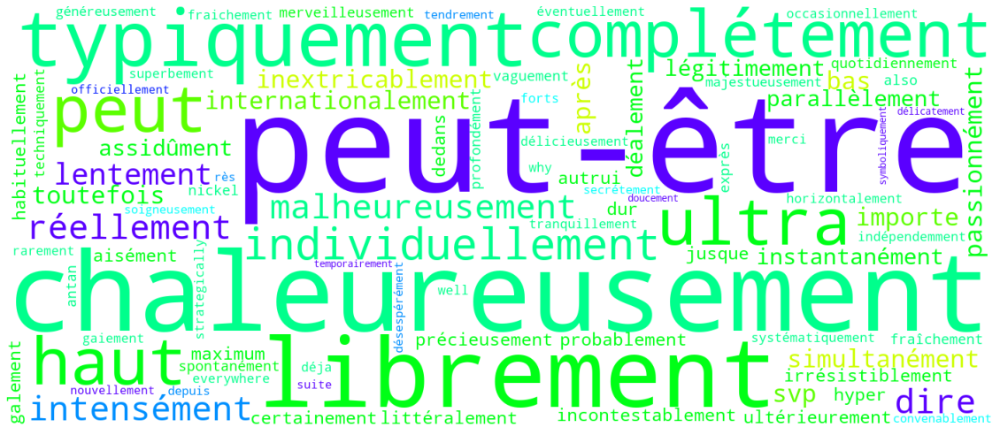

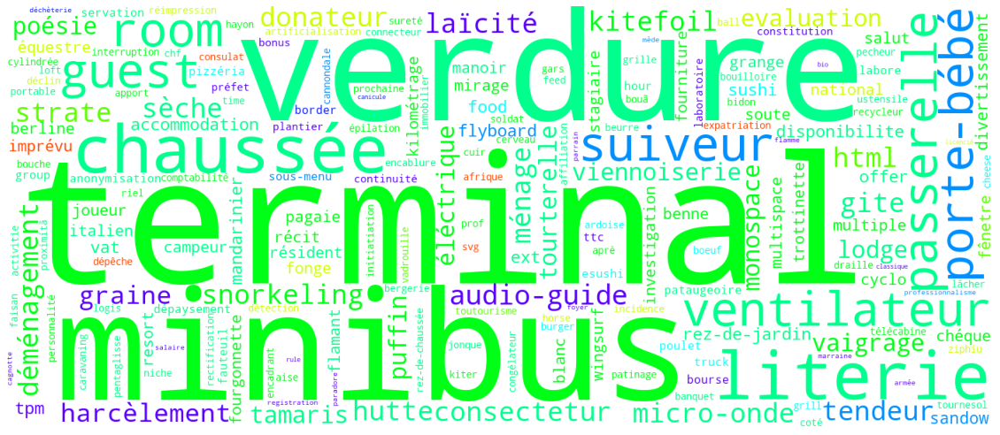

In [ ]:
# 2e méthode  
seuil1 = 1
seuil2 = 15
tempo = dict()
for cat in catGram:
  tempo[cat] = dict() # reconstruction du compteur de mots qui contiendra les mots à représenter et leur occ
  for ndf in CountMots.keys():
      for mot in diff[ndf][cat]:
        if mot in CountMots [ndf][cat].keys():
          if CountMots[ndf][cat][mot] > seuil1 and CountMots[ndf][cat][mot] < seuil2 : # en mettant inférieur --> signaux faibles
                                                  # en mettant supérieur --> signaux forts ou évidents
                                                  # écrétage entre seuil1 et 2
            tempo[cat][mot] = CountMots[ndf][cat][mot]
          else:
            pass
      #print (len(tempo.split()))
  if len(tempo[cat]) >0:
    makeImage2(tempo[cat], palette, couleursMots, leg = False) # true pour legend
  else:
    print("vide")
  print(cat)

## Représentations de la totalité des mots d'une catégorie et mots communs à tous

> en excluant les trivaux (occurrence maximale)

In [ ]:
aExclure += 'décembre novembre détail suite vendredi nov'.split()

Gouv VERB 361 99


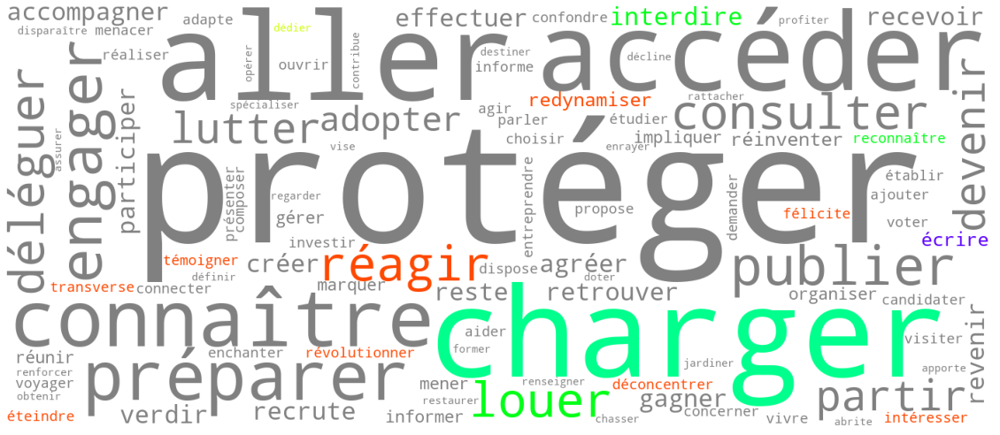

Gouv ADJ 795 150


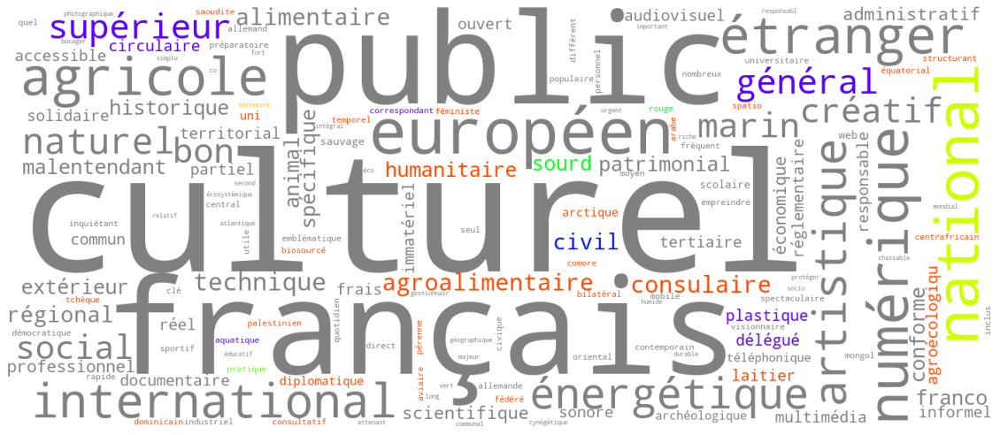

Gouv ADV 52 14


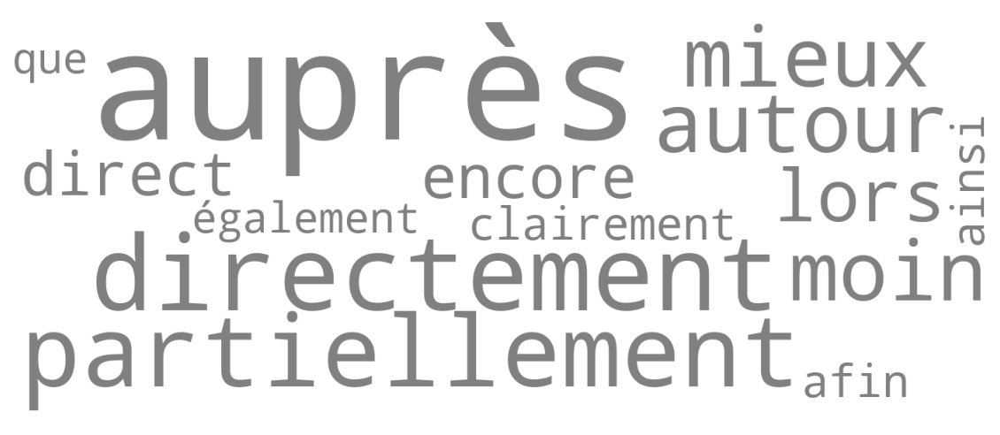

Gouv NOUN 2717 491


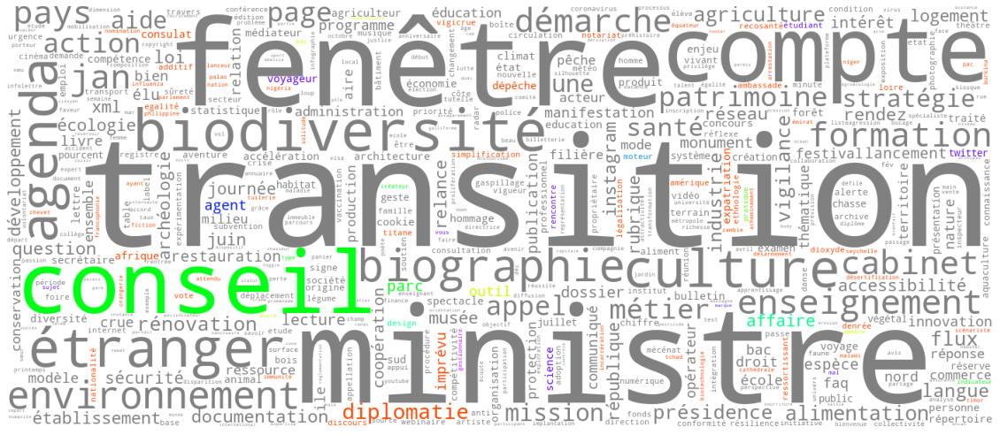

parcs VERB 790 193


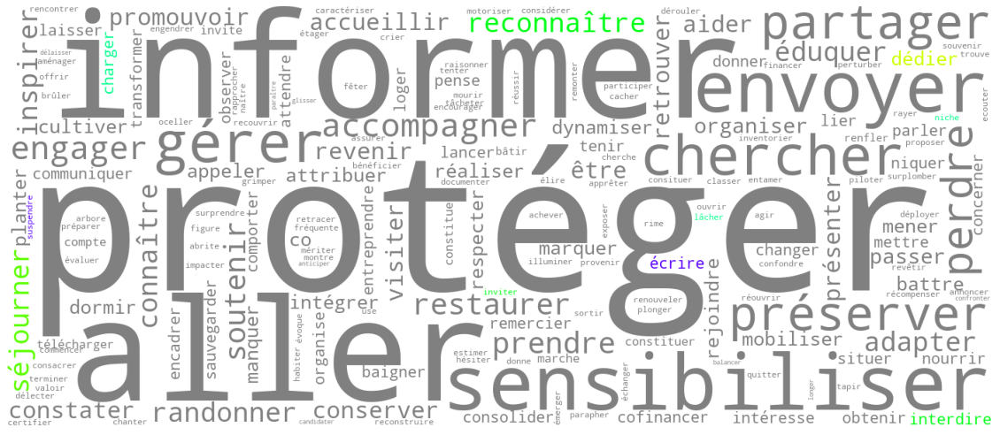

parcs ADJ 1987 273


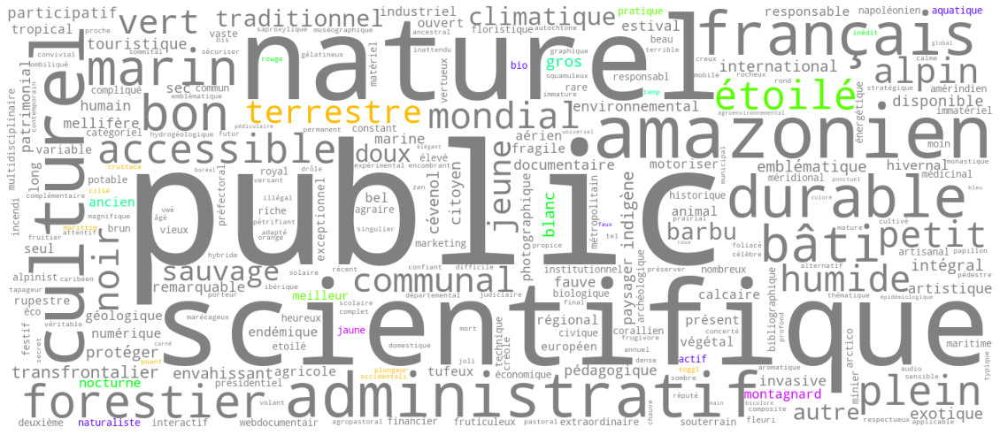

parcs ADV 153 46


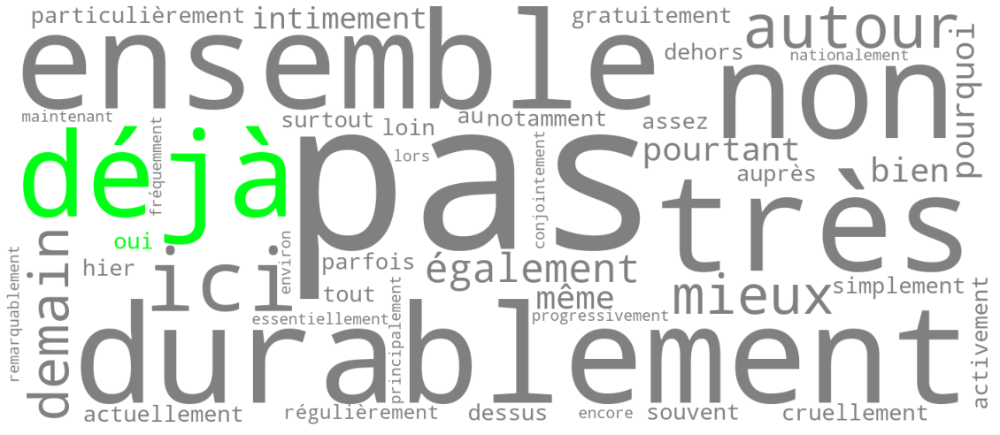

parcs NOUN 6314 900


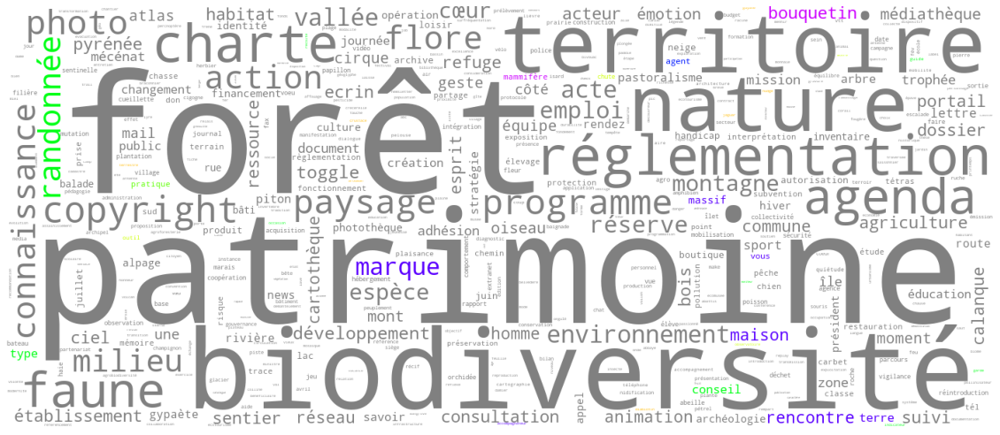

organisations VERB 1110 264


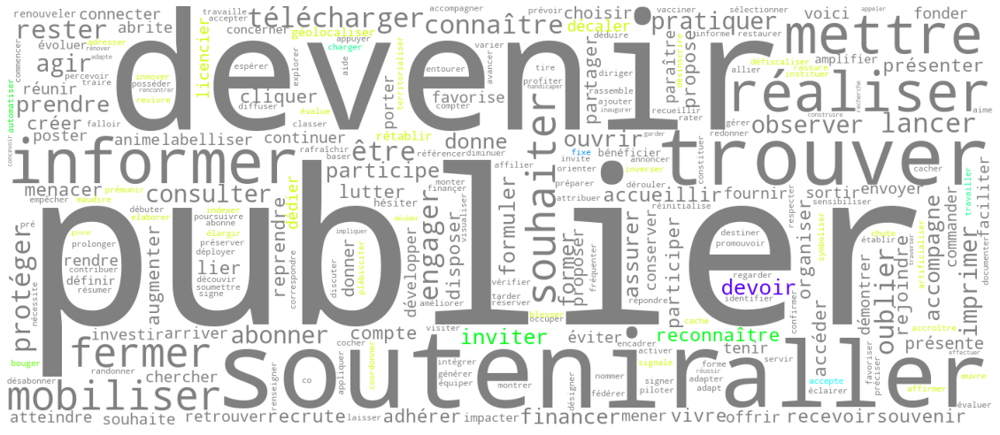

organisations ADJ 1722 285


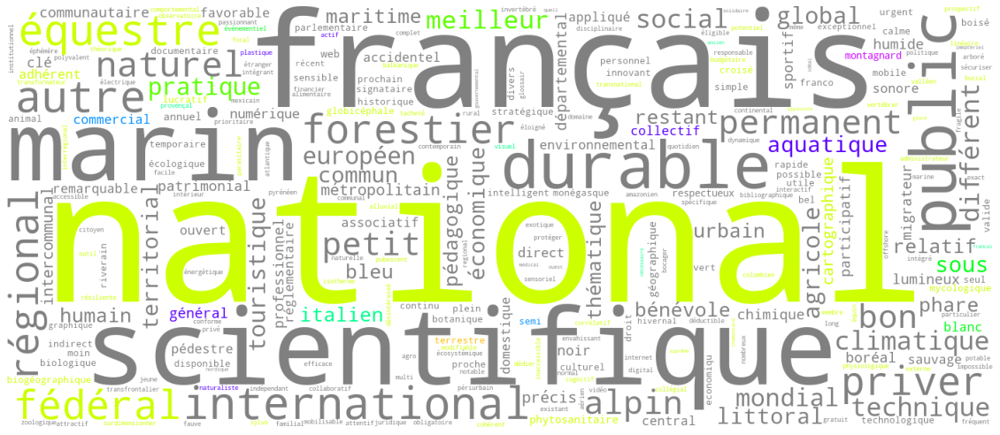

organisations ADV 200 57


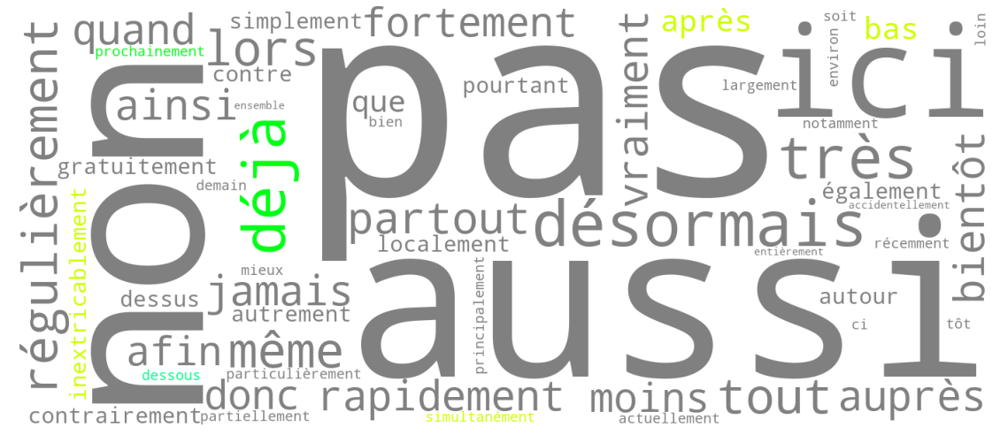

organisations NOUN 5783 950


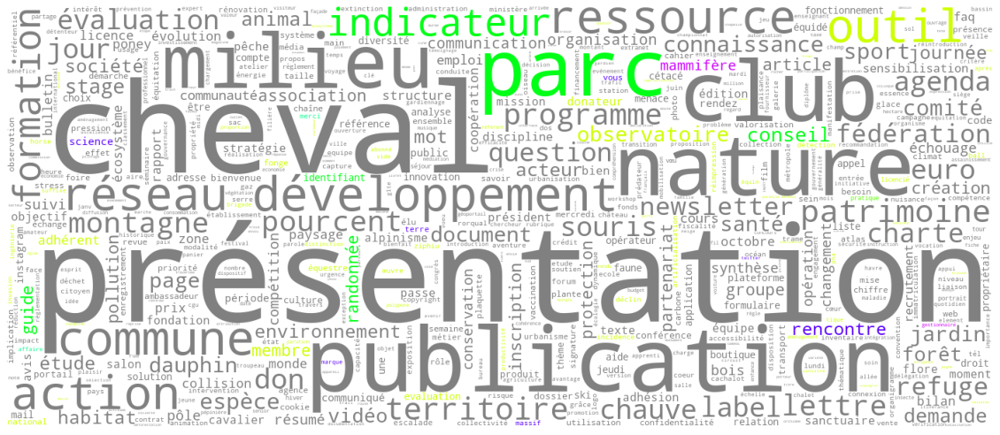

oTourism VERB 1620 302


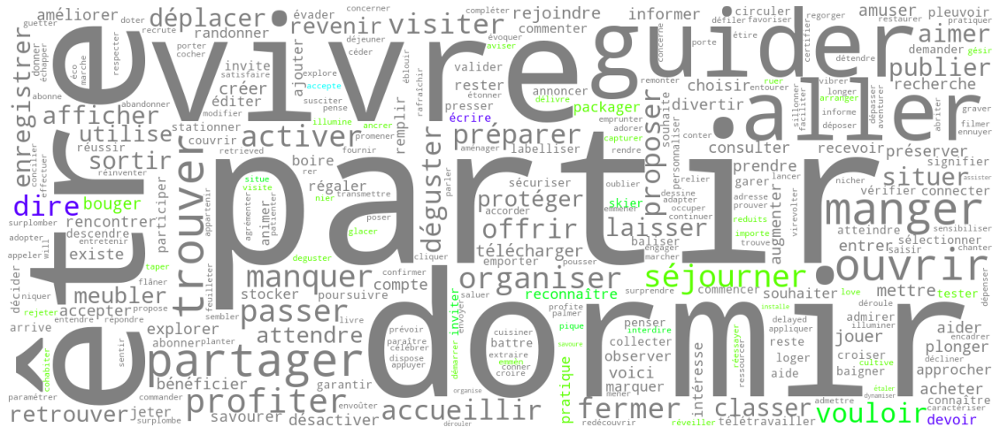

oTourism ADJ 1896 320


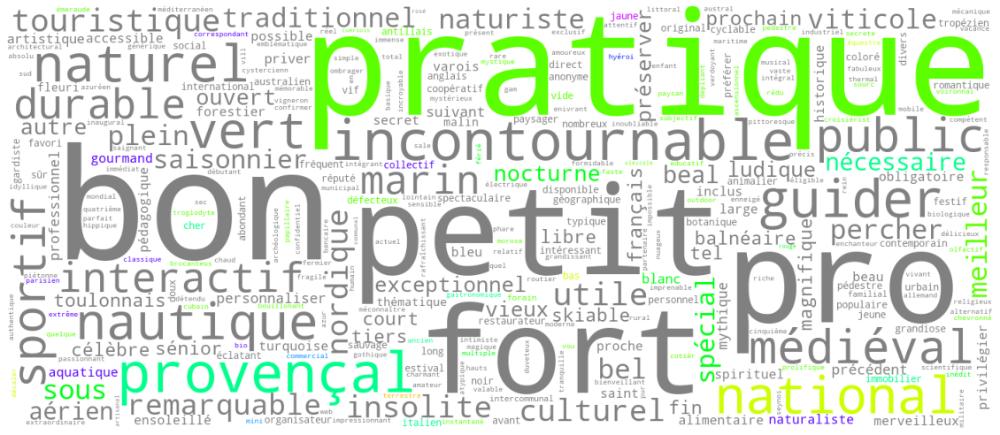

oTourism ADV 338 69


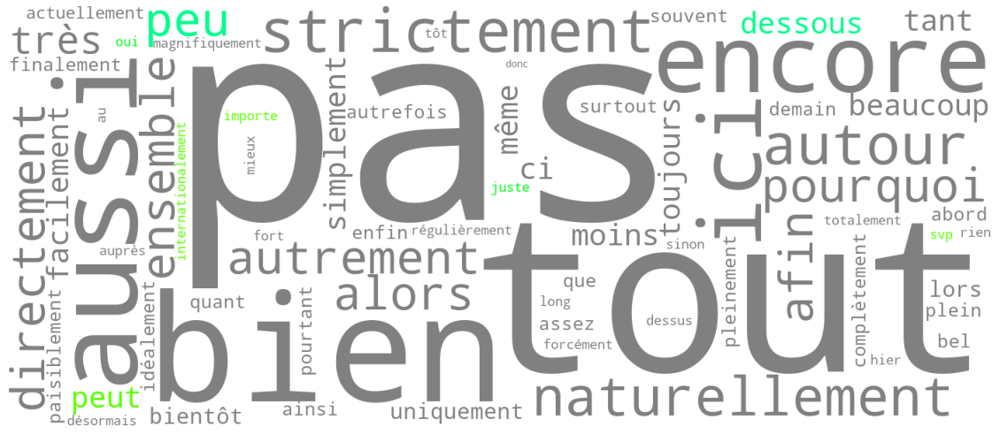

oTourism NOUN 7941 1025


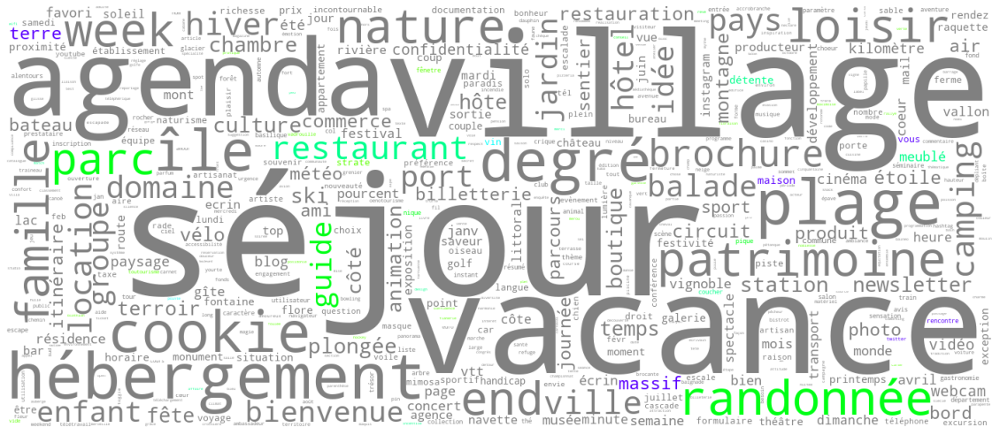

Services VERB 5362 735


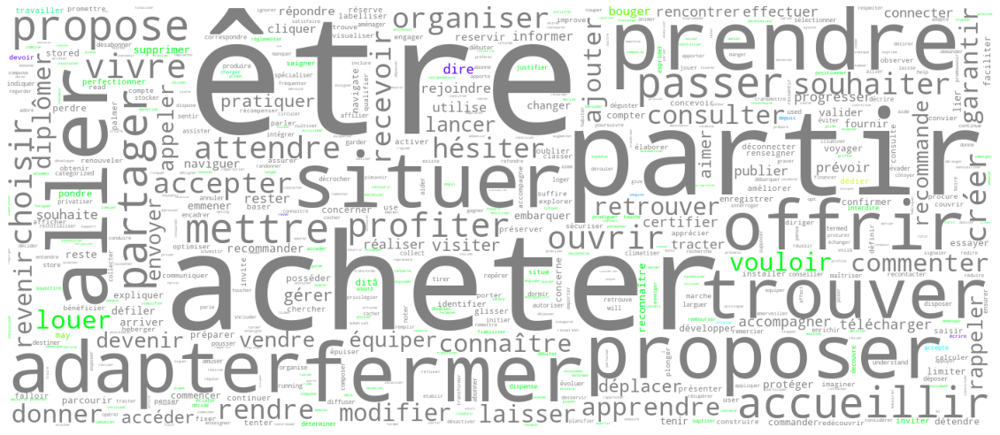

Services ADJ 5344 704


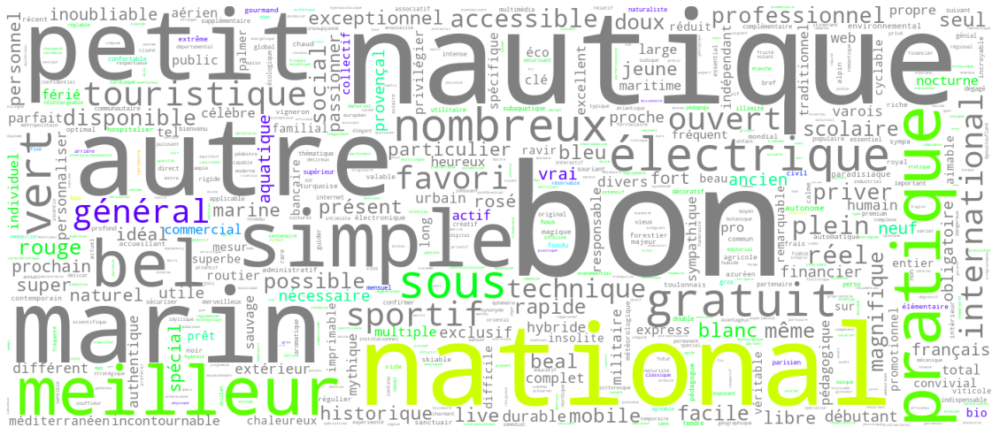

Services ADV 1648 159


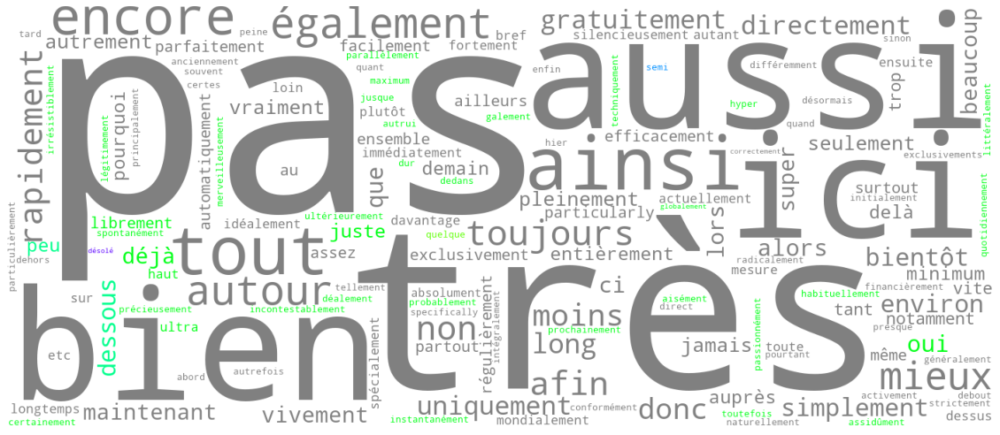

Services NOUN 25229 2262


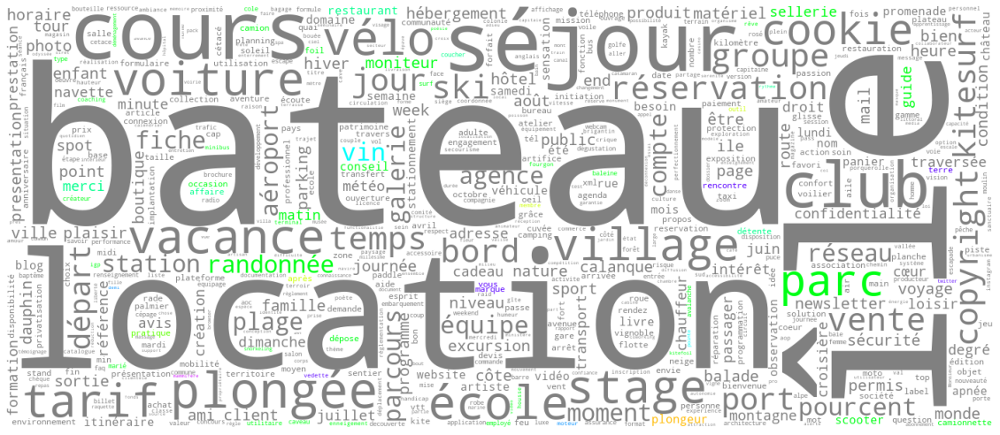

Hebergement VERB 5659 689


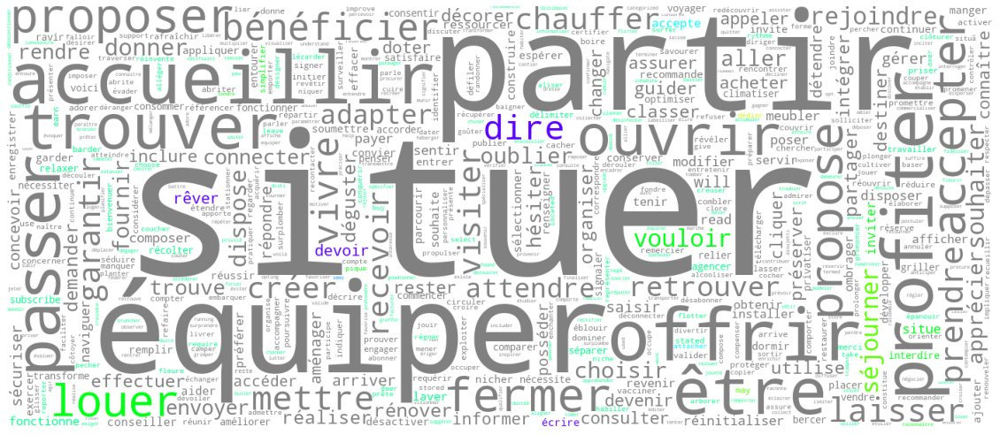

Hebergement ADJ 5666 623


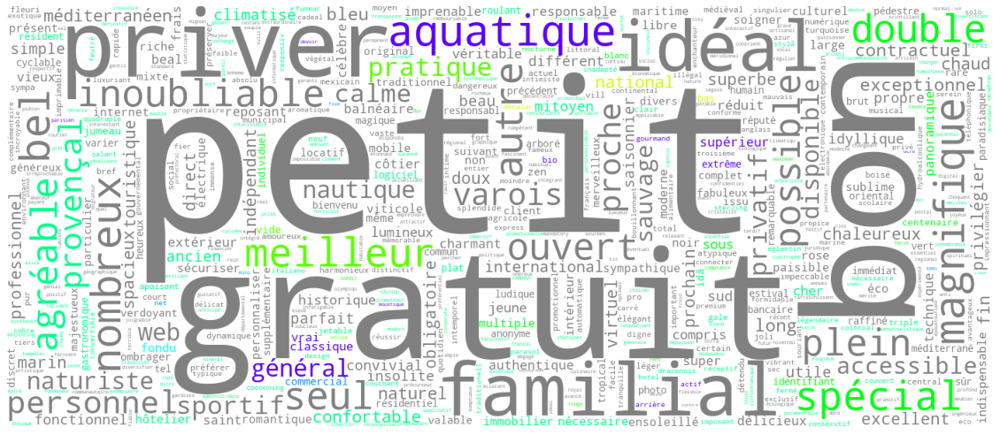

Hebergement ADV 1718 153


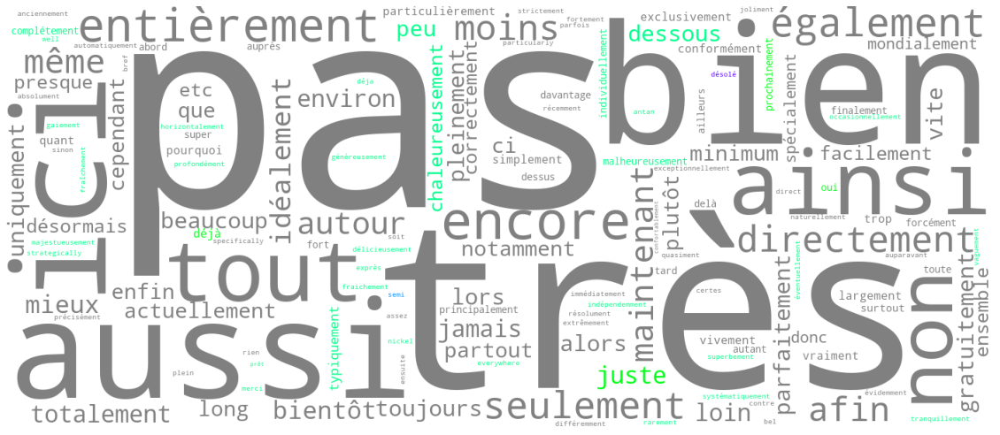

Hebergement NOUN 25129 1923


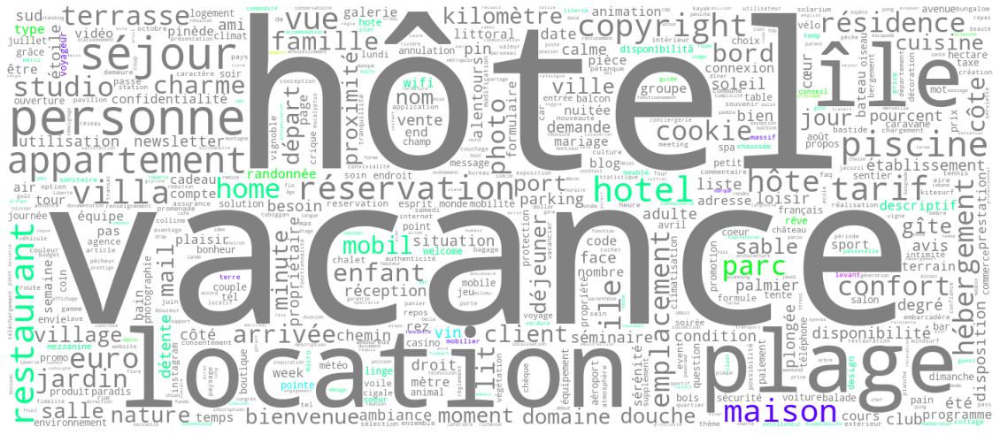

restauration VERB 915 213


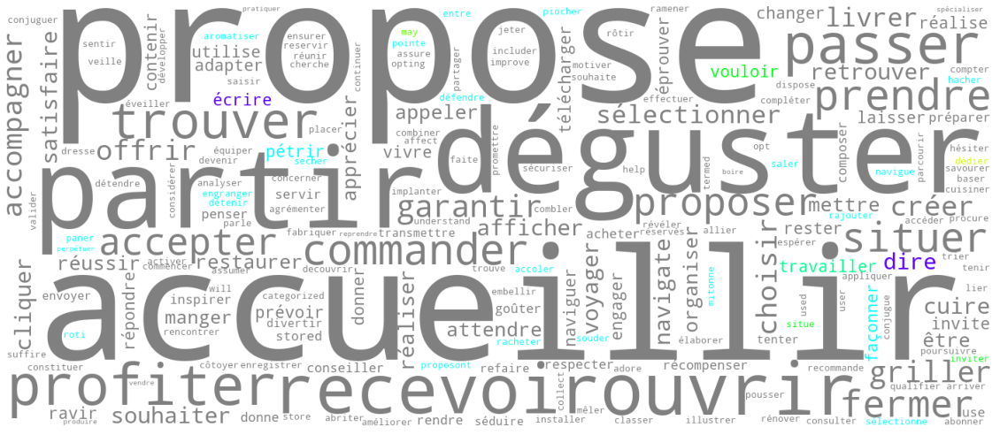

restauration ADJ 795 180


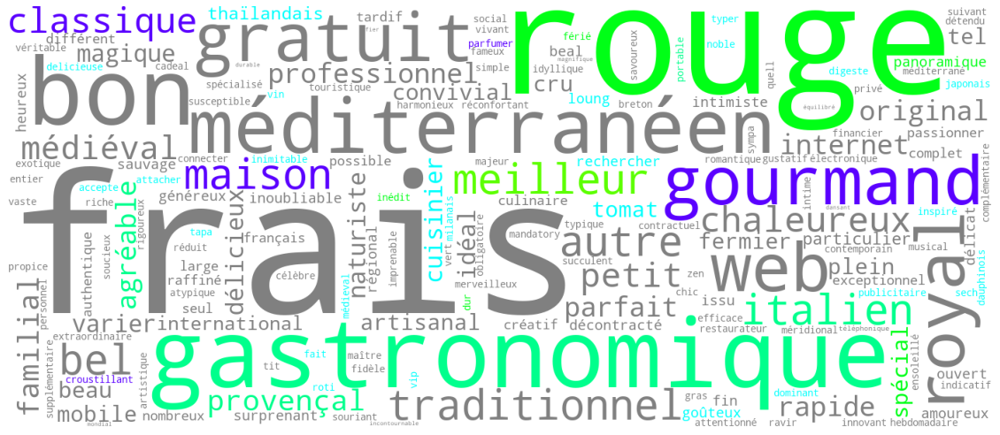

restauration ADV 237 48


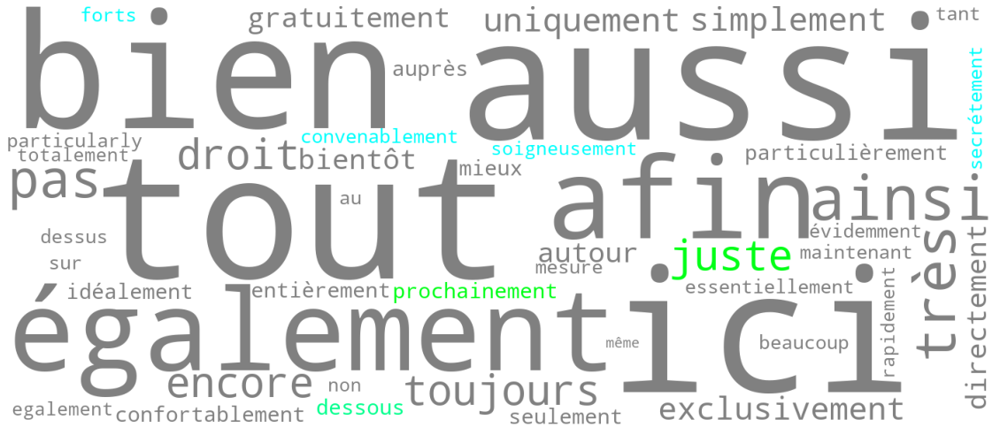

restauration NOUN 3442 643


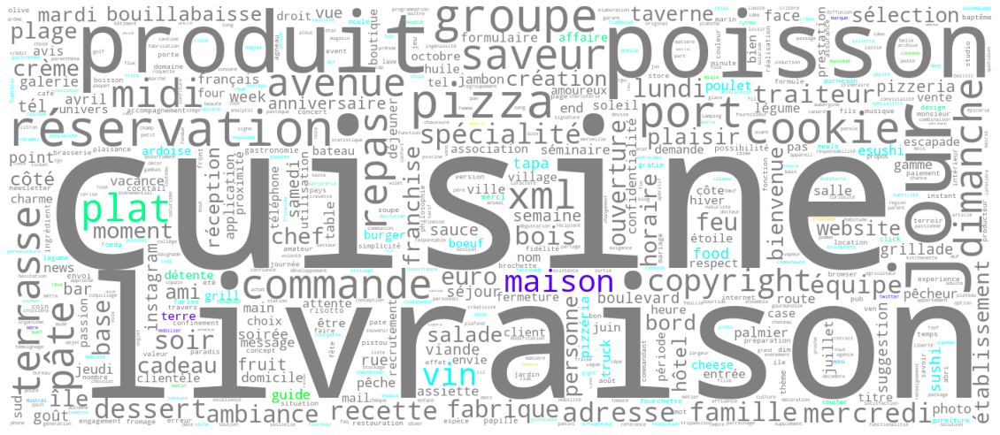

locations VERB 1697 320


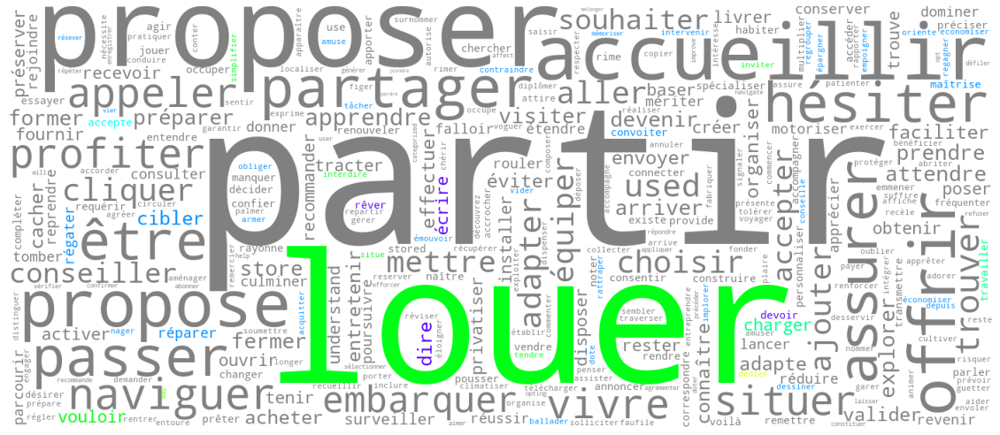

locations ADJ 1459 270


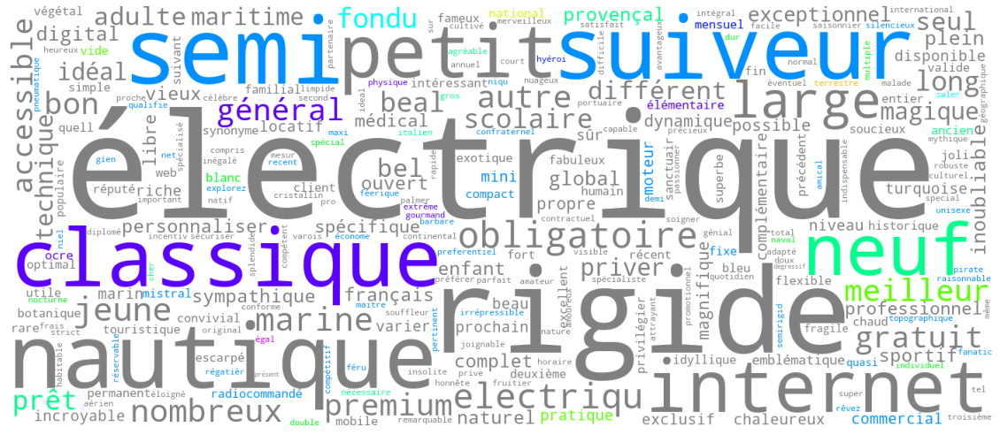

locations ADV 498 80


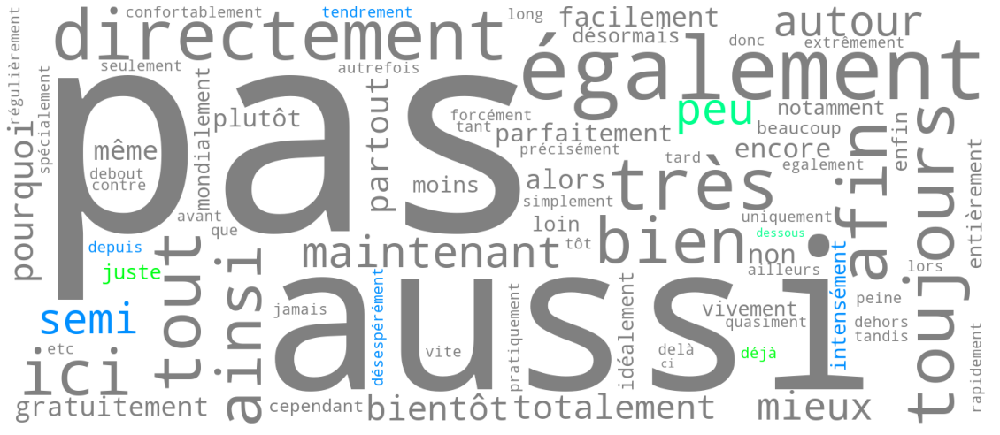

locations NOUN 8172 879


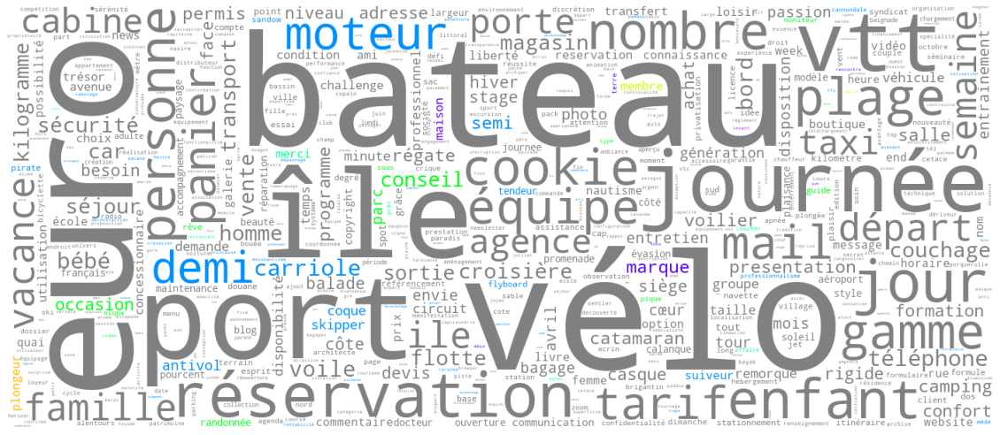

mairies VERB 291 113


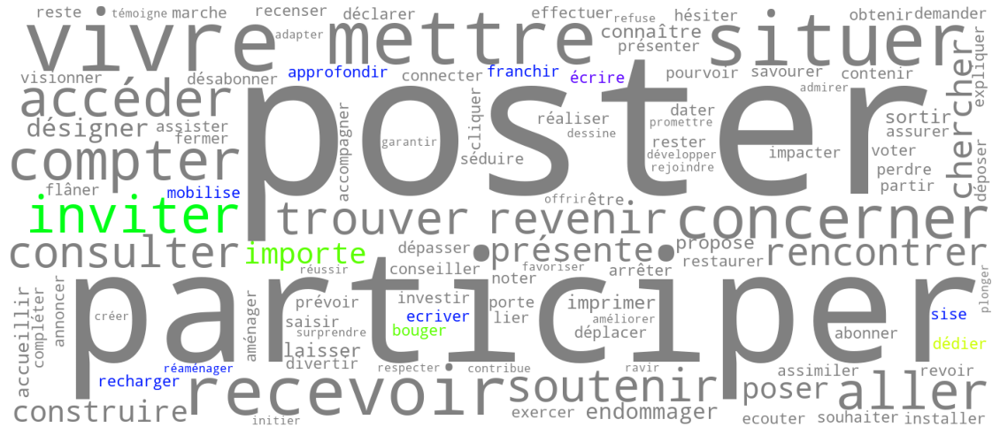

mairies ADJ 567 143


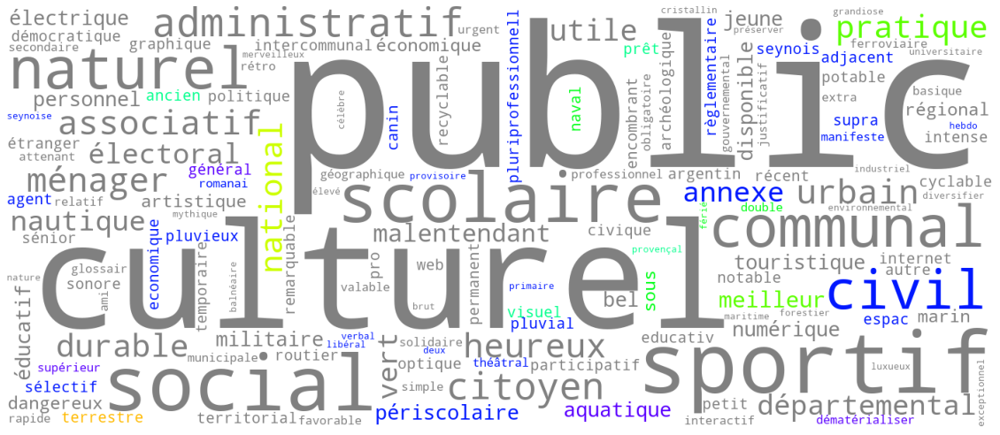

mairies ADV 44 19


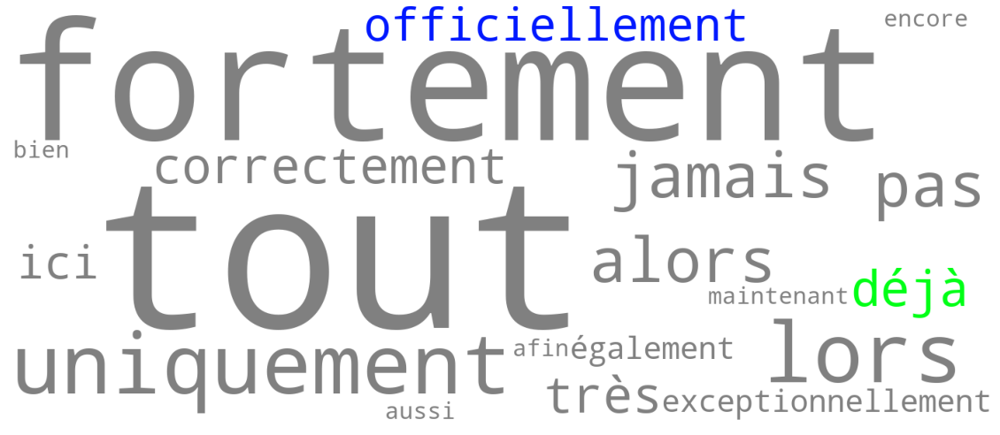

mairies NOUN 2592 597


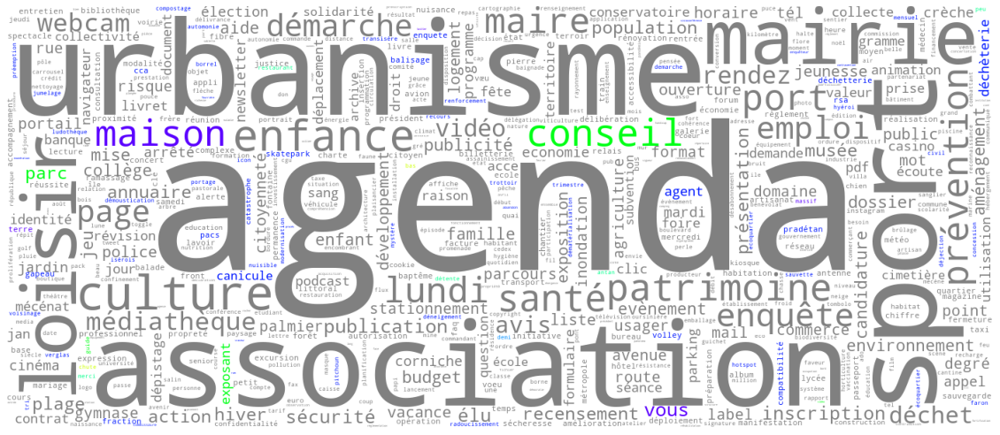

In [ ]:
tempo = dict()
seuil = 0 # occurence à partir de laquelle démarrer

for ndf in RefdicoEtiquettage.keys():
  for cat in catGram:
    tempo[cat] = ""
    seuil2 = max([CountMots[ndf][cat][mot] for mot in CountMots[ndf][cat]]) #seuil
    for mot in CountMots[ndf][cat].keys():
      if CountMots[ndf][cat][mot] >seuil and CountMots[ndf][cat][mot] <seuil2 and mot not in aExclure and (mot in diff[ndf][cat] or mot in communs[ndf][cat]):
        tempo[cat] += (mot + ' ') * CountMots[ndf][cat][mot]
    print (ndf, cat, len(tempo[cat].split()), len(set(tempo[cat].split())))
    makeImage(tempo[cat],  palette,couleursMots)